### Installing dependencies

In [1]:
# Install necessary libraries for data analysis and clustering algorithms.

# - scikit-learn: Core library for ML algorithms (K-Means, DBSCAN, Hierarchical) and metrics.
# - hdbscan: Implementation of the HDBSCAN algorithm.
# - pyclustering: Library containing G-Means implementation.
# - seaborn/matplotlib: Data visualization.
# - pandas/numpy: Data manipulation.
# - factor_analyzer: Extraction of factors.

%pip install pandas numpy matplotlib seaborn scikit-learn hdbscan pyclustering factor_analyzer setuptools

Note: you may need to restart the kernel to use updated packages.


### Importing nessesary libraries

In [2]:
# For classes and methods
from typing import Callable

# For data manipulation
import pandas as pd
import numpy as np

# For visualization
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns

# For statistical tests and preprocessing
from sklearn import metrics
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import pairwise_distances, silhouette_score, silhouette_samples
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import StandardScaler
import hdbscan
from scipy.linalg import svd
from factor_analyzer import FactorAnalyzer
from factor_analyzer.factor_analyzer import calculate_bartlett_sphericity, calculate_kmo

### Helper methods

In [3]:
# Helper function for cluster visualization
def plot_cluster_pairplot(df_factors, labels, color_map, n_samples, lower_quantile, upper_quantile, title="Categorized scatter plot matrix"):
    # Create a temporary DataFrame for plotting
    df_plot = df_factors.copy()
    df_plot['Cluster'] = labels
    
    # Plotting all points can be slow and cluttered. We use a sample.
    if len(df_plot) > n_samples:
        df_sample = df_plot.sample(n=n_samples, random_state=42)
    else:
        df_sample = df_plot.copy()
        
    print(f"Generating pairplot for '{title}' using {len(df_sample)} sample points...")

    # Generate the pairplot
    pairplot_fig = sns.pairplot(
        df_sample, 
        vars=[col for col in df_factors.columns], 
        hue='Cluster', 
        palette=color_map,
        diag_kind='kde',
        plot_kws={'alpha': 0.5, 's': 15, 'linewidth': 0}
    )

    # Axis trimming
    for i in range(df_factors.shape[1]):
        for j in range(df_factors.shape[1]):
            if i != j:
                ax = pairplot_fig.axes[i, j]
                x_factor_name = df_factors.columns[j]
                y_factor_name = df_factors.columns[i]
                
                x_min, x_max = df_sample[x_factor_name].quantile([lower_quantile, upper_quantile])
                y_min, y_max = df_sample[y_factor_name].quantile([lower_quantile, upper_quantile])
                
                ax.set_xlim(x_min, x_max)
                ax.set_ylim(y_min, y_max)

    pairplot_fig.fig.suptitle(title, y=1.02, fontsize=16)
    plt.show()

In [4]:
# Helper function for metrics calculation
def calculate_and_print_metrics(data, true_labels, predicted_labels):    
    # External metrics
    
    # Rand
    rand_index = metrics.rand_score(true_labels, predicted_labels)
    
    # ARI
    adj_rand_index = metrics.adjusted_rand_score(true_labels, predicted_labels)
    
    # Jaccard Index
    contingency = metrics.cluster.contingency_matrix(true_labels, predicted_labels)
    
    tp = np.sum(contingency * (contingency - 1) / 2)
    fp = np.sum(np.sum(contingency, axis=0) * (np.sum(contingency, axis=0) - 1) / 2) - tp
    fn = np.sum(np.sum(contingency, axis=1) * (np.sum(contingency, axis=1) - 1) / 2) - tp
    
    jaccard_index = tp / (tp + fp + fn) if (tp + fp + fn) > 0 else 0

    # Internal metrics 
    
    # Silhouette
    silhouette = metrics.silhouette_score(data, predicted_labels)
    
    data_np = np.array(data)
    unique_clusters = np.unique(predicted_labels)
    centroids = np.array([data_np[predicted_labels == i].mean(axis=0) for i in unique_clusters])
    
    # Compactness (Within-Cluster Sum of Squares - WSS)
    wss = 0
    unique_labels = np.unique(predicted_labels)
    for i in unique_labels:
        cluster_points = data[predicted_labels == i]
        if len(cluster_points) > 0:
            centroid = cluster_points.mean(axis=0)
            wss += np.sum((cluster_points - centroid) ** 2)
    compactness = np.sum(wss)
        
    # Separation (Between-Cluster Sum of Squares - BSS)
    overall_mean = data_np.mean(axis=0)
    separation = 0
    for i, cluster_label in enumerate(unique_clusters):
        cluster_points = data_np[predicted_labels == cluster_label]
        n_points = len(cluster_points)
        separation += n_points * np.sum((centroids[i] - overall_mean)**2)

    # Print results
    print("External metrics:")
    print(f"- Rand Index (RI):           {rand_index:.4f}")
    print(f"- Adjusted Rand Index (ARI): {adj_rand_index:.4f}")
    print(f"- Jaccard Index:             {jaccard_index:.4f}")
    
    print("\nInternal metrics:")
    print(f"- Silhouette Score:        {silhouette:.4f}")
    print(f"- Compactness (WSS):       {compactness:.4f}")
    print(f"- Separation (BSS):        {separation:.4f}")
    
    # Store metrics in a dictionary to return
    results = {
        'Rand Index': rand_index,
        'ARI': adj_rand_index,
        'Jaccard Index': jaccard_index,
        'Silhouette': silhouette,
        'Compactness': compactness,
        'Separation': separation
    }
    
    return results

In [5]:
# Helper function to analyze cluster characteristics
def analyze_clusters(data, labels, model=None):
    unique_labels = np.unique(labels)
    cluster_labels = [l for l in unique_labels if l != -1]
    n_clusters = len(cluster_labels)
    
    # Calculate cluster sizes
    cluster_sizes = pd.Series(labels).value_counts().sort_index()
    print("Size of each cluster:")
    print(cluster_sizes)

    # Calculate cluster centers
    centers = None
    if hasattr(model, 'cluster_centers_'):
        # Use pre-computed centers from the model
        centers = model.cluster_centers_
        print("Cluster centers:")
    else:
        # Manually compute centers as the mean of points in each cluster
        if n_clusters > 0:
            centers = np.array([data[labels == i].mean(axis=0) for i in cluster_labels])
            print("Cluster centers:")
        else:
            print("No clusters found to compute centers.")
            
    if centers is not None:
        centers_df = pd.DataFrame(centers, index=cluster_labels, columns=data.columns)
        print(centers_df)
    else:
        centers_df = pd.DataFrame()

    # Pairwise distances between cluster centers
    print("Pairwise distances between cluster centers:")
    
    # Euclidean Distance
    euclidean_distances = pairwise_distances(centers, metric='euclidean')
    euclidean_df = pd.DataFrame(euclidean_distances, index=cluster_labels, columns=cluster_labels)
    print("\nEuclidean distance:")
    print(euclidean_df)

    # Manhattan Distance
    manhattan_distances = pairwise_distances(centers, metric='manhattan')
    manhattan_df = pd.DataFrame(manhattan_distances, index=cluster_labels, columns=cluster_labels)
    print("\nManhattan distance:")
    print(manhattan_df)

    # Chebyshev Distance
    chebyshev_distances = pairwise_distances(centers, metric='chebyshev')
    chebyshev_df = pd.DataFrame(chebyshev_distances, index=cluster_labels, columns=cluster_labels)
    print("\nChebyshev distance:")
    print(chebyshev_df)
    
    results = {
        'sizes': cluster_sizes,
        'centers': centers_df,
        'euclidean_distances': euclidean_df,
        'manhattan_distances': manhattan_df,
        'chebyshev_distances': chebyshev_df
    }
    
    return results

In [6]:
# Helper function for plotting silhouette diagrams
def plot_silhouette_diagram(data, labels, model_name):
    # Filter out noise points
    mask_clustered = labels != -1
    data_clustered = data[mask_clustered]
    labels_clustered = labels[mask_clustered]
    
    unique_cluster_labels = np.unique(labels_clustered)
    n_clusters = len(unique_cluster_labels)

    # Check if a plot can be generated
    if n_clusters < 2:
        print(f"Silhouette plot cannot be generated for '{model_name}': Found fewer than 2 clusters.")
        return

    print(f"Generating silhouette plot for '{model_name}' (found {n_clusters} clusters)...")
    
    # Calculate silhouette scores
    silhouette_avg = silhouette_score(data_clustered, labels_clustered)
    print(f"The average silhouette score for all clustered points is: {silhouette_avg:.4f}")
    sample_silhouette_values = silhouette_samples(data_clustered, labels_clustered)

    # Create the plot
    fig, ax1 = plt.subplots(1, 1)
    fig.set_size_inches(18, 10)

    y_lower = 10 
    for i in unique_cluster_labels:
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[labels_clustered == i]
        ith_cluster_silhouette_values.sort()
        
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Choose a color for the cluster
        color = cm.nipy_spectral(float(i) / n_clusters if n_clusters > 1 else 1.0)
        
        # Fill the silhouette plot for the current cluster
        ax1.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)
        
        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        
        # Compute the new y_lower for the next plot
        y_lower = y_upper + 10

    # Finalize the plot
    ax1.set_title(f"Silhouette Plot for {model_name} Clustering", fontsize=16)
    ax1.set_xlabel("Silhouette coefficient values", fontsize=14)
    ax1.set_ylabel("Cluster label", fontsize=14)

    ax1.axvline(x=silhouette_avg, color="red", linestyle="--", label=f'Average Silhouette: {silhouette_avg:.4f}')

    ax1.set_yticks([])
    ax1.set_xticks([-0.2, 0, 0.2, 0.4, 0.6, 0.8, 1])
    ax1.legend()
    
    plt.show()

In [7]:
# Helper function to calculate and plot feature importance
def plot_feature_importance(data, labels, model_name):
    # Filter out noise points
    mask_clustered = labels != -1
    data_clustered = data[mask_clustered]
    labels_clustered = labels[mask_clustered]
    
    unique_cluster_labels = np.unique(labels_clustered)
    k = len(unique_cluster_labels)
    N = len(data_clustered)

    # Check if importance can be calculated
    if k < 2:
        print(f"Feature importance cannot be calculated for '{model_name}': Found fewer than 2 clusters.")
        return None
        
    print(f"Calculating feature importance for '{model_name}'...")

    f_statistics = {}
    for feature in data.columns:
        # Calculate Sum of Squares Between (SSB)
        overall_mean = data_clustered[feature].mean()
        ssb = 0
        for label in unique_cluster_labels:
            cluster_data = data_clustered.loc[labels_clustered == label, feature]
            n_i = len(cluster_data)
            if n_i > 0:
                mean_i = cluster_data.mean()
                ssb += n_i * (mean_i - overall_mean) ** 2

        # Calculate Sum of Squares Within (SSW)
        ssw = 0
        for label in unique_cluster_labels:
            cluster_data = data_clustered.loc[labels_clustered == label, feature]
            if len(cluster_data) > 0:
                mean_i = cluster_data.mean()
                ssw += np.sum((cluster_data - mean_i) ** 2)
            
        # Calculate F-statistic
        df_between = k - 1
        df_within = N - k
        
        if df_between <= 0 or df_within <= 0:
            f_statistics[feature] = 0
            continue
        
        msb = ssb / df_between
        msw = ssw / df_within
        
        f_stat = msb / msw if msw > 0 else 0
        f_statistics[feature] = f_stat

    # Prepare data for plotting
    importance_df = pd.DataFrame.from_dict(f_statistics, orient='index', columns=['F-Statistic'])
    importance_df = importance_df.sort_values(by='F-Statistic', ascending=True)

    # Create the bar plot
    plt.figure(figsize=(16, 12))
    importance_df.plot(kind='barh', legend=False, color='skyblue')
    plt.title(f'Feature Importance for {model_name} clustering', fontsize=16)
    plt.xlabel('F-Statistic', fontsize=12)
    plt.ylabel('Factors', fontsize=12)
    plt.grid(axis='x', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()
    
    return importance_df.sort_values(by='F-Statistic', ascending=False)

### Loading the dataset

In [16]:
# Load the data into a pandas DataFrame
print("Loading data:")
try:
    df_full = pd.read_csv('dataset.csv')
    print("Dataset 'dataset.csv' loaded successfully.")
except FileNotFoundError:
    print("Error: 'dataset.csv' not found. Please ensure the file is in the correct directory.")
    exit()

# Perform an initial inspection of the data
print("\nInitial data inspection:")
print("First 5 rows of the dataset:")
print(df_full.head())

print("\nDataset information:")
df_full.info()

print("\nChecking for missing values:")
print(df_full.isnull().sum())
print("No missing values found.")

Loading data:
Dataset 'dataset.csv' loaded successfully.

Initial data inspection:
First 5 rows of the dataset:
                                Flow ID      Src IP  Src Port  \
0           100.64.0.2-100.64.0.1-0-0-0  100.64.0.2         0   
1  10.16.0.6-144.122.71.18-34788-6443-6   10.16.0.6     34788   
2         10.16.0.6-144.122.71.18-0-0-0   10.16.0.6         0   
3       10.16.0.6-114.114.114.114-0-0-0   10.16.0.6         0   
4  10.16.0.2-144.122.71.18-56026-6443-6   10.16.0.2     56026   

            Dst IP  Dst Port  Protocol                   Timestamp  \
0       100.64.0.1         0         0  2023-03-19 15:02:20.266440   
1    144.122.71.18      6443         6  2023-03-19 15:02:22.387673   
2    144.122.71.18         0         0  2023-03-19 15:02:22.901650   
3  114.114.114.114         0         0  2023-03-19 15:02:23.119110   
4    144.122.71.18      6443         6  2023-03-19 15:02:23.109867   

   Flow Duration  Total Fwd Packet  Total Bwd packets  ...    Active Mean  \

### Preprocessing the dataset

In [17]:
# Use full dataset if small, otherwise undersample
threshold = 100_000

if len(df_full) > threshold:
    frac_sample = 0.02
    df = df_full.sample(frac=frac_sample, random_state=42).copy()
    print(f"Undersampling applied. Original size: {df_full.shape[0]}, New size: {df.shape[0]}")
else:
    df = df_full.copy()
    print(f"Skipping undersampling. Size: {df.shape[0]}")

# Separate labels for metrics calculation
ground_truth = df['Label'].copy()

# Drop the columns that are not useful for analysis
cols_to_drop = ['Flow ID', 'Src IP', 'Dst IP', 'Timestamp', 'Label']
df.drop(columns=cols_to_drop, inplace=True, errors='ignore')

# Drop rows with any missing values
df.replace([np.inf, -np.inf], np.nan, inplace=True)
df.dropna(inplace=True)
ground_truth = ground_truth.loc[df.index]
print("\nRows with missing values have been dropped.")

# Drop columns with zero variance
non_constant_cols = df.loc[:, df.std() > 0].columns
dropped_const_cols = set(df.columns) - set(non_constant_cols)
df = df[non_constant_cols]

# Check the shape of the dataframe after cleaning
print(f"The shape of the cleaned dataset is: {df.shape}")

# Display the first few rows again to see the changes
print("\nData inpection after conversion:")
print("First 5 rows of the processed dataset:")
print(df.head())

print("\nUpdated dataset information:")
df.info()

Undersampling applied. Original size: 3231475, New size: 64630

Rows with missing values have been dropped.
The shape of the cleaned dataset is: (63776, 77)

Data inpection after conversion:
First 5 rows of the processed dataset:
         Src Port  Dst Port  Protocol  Flow Duration  Total Fwd Packet  \
1496389     58172      8080         6          77583                 6   
1135783     42998      8080         6           1832                 6   
458046      20882      8080         6          16588                 5   
2706451     49812      8080         6      119914905              5451   
1676252      9627      8080         6        1000675                64   

         Total Bwd packets  Total Length of Fwd Packet  \
1496389                  5                       517.0   
1135783                  5                       544.0   
458046                   5                       530.0   
2706451               3896                    640943.0   
1676252                 37         

### Inspecting the dataset

In [10]:
# Calculate and display descriptive statistics
print("\nDescriptive statistics:")
descriptive_stats = df.describe()
print(descriptive_stats)

# Calculate and display skewness and kurtosis
print("\nSkewness and kurtosis:")
skewness = df.skew()
kurtosis = df.kurt()
stats_summary = pd.DataFrame({'Skewness': skewness, 'Kurtosis': kurtosis})
print(stats_summary)


Descriptive statistics:
           Src Port      Dst Port      Protocol  Flow Duration  \
count  63776.000000  63776.000000  63776.000000   6.377600e+04   
mean   37882.437563   7854.001599      6.197096   7.162741e+06   
std    17412.179211   4082.938728      1.555741   2.492764e+07   
min        0.000000      0.000000      0.000000   7.000000e+00   
25%    25551.000000   8080.000000      6.000000   8.667500e+03   
50%    40888.000000   8080.000000      6.000000   3.925200e+04   
75%    52029.250000   8080.000000      6.000000   1.378250e+05   
max    65535.000000  60438.000000     17.000000   1.200000e+08   

       Total Fwd Packet  Total Bwd packets  Total Length of Fwd Packet  \
count      63776.000000       63776.000000                6.377600e+04   
mean         132.186183         108.874169                6.851238e+04   
std          692.978139         596.503673                6.528118e+05   
min            0.000000           0.000000                0.000000e+00   
25%       

In [11]:
# Calculate the number of bins using Sturges' formula
n = len(df)
num_bins = int(np.ceil(1 + np.log2(n)))

print(f"Number of observations: {n}")
print(f"Calculated number of bins using Sturges' formula: {num_bins}")

Number of observations: 63776
Calculated number of bins using Sturges' formula: 17



Generating histograms for each variable:


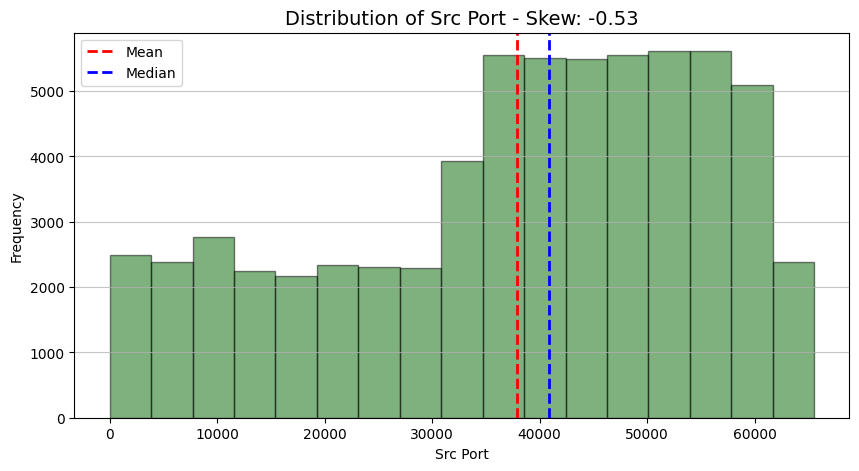

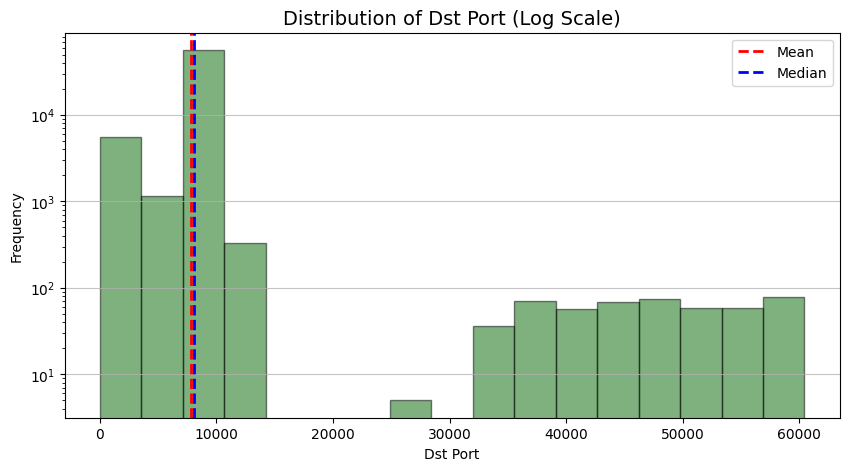

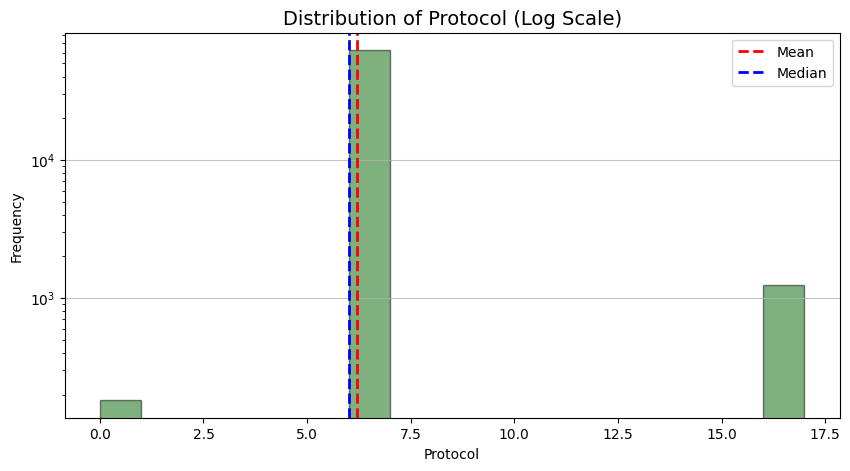

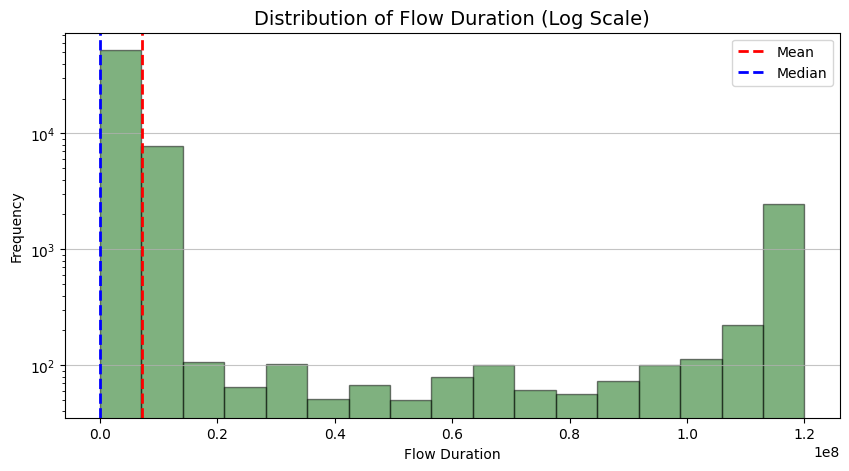

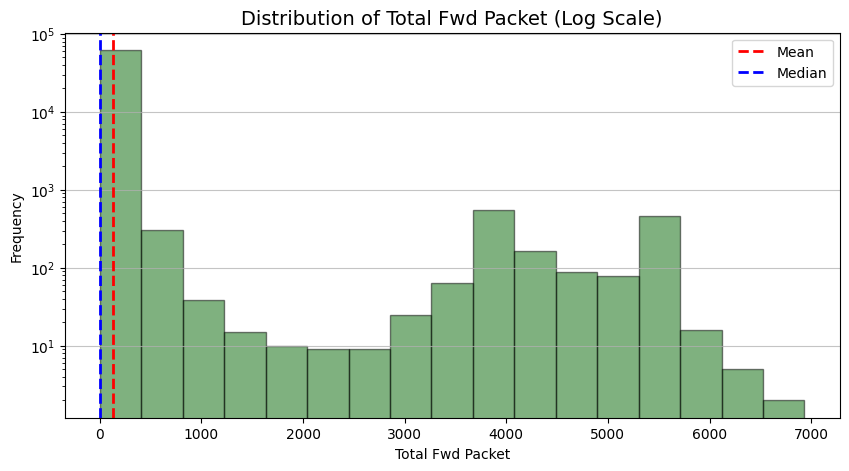

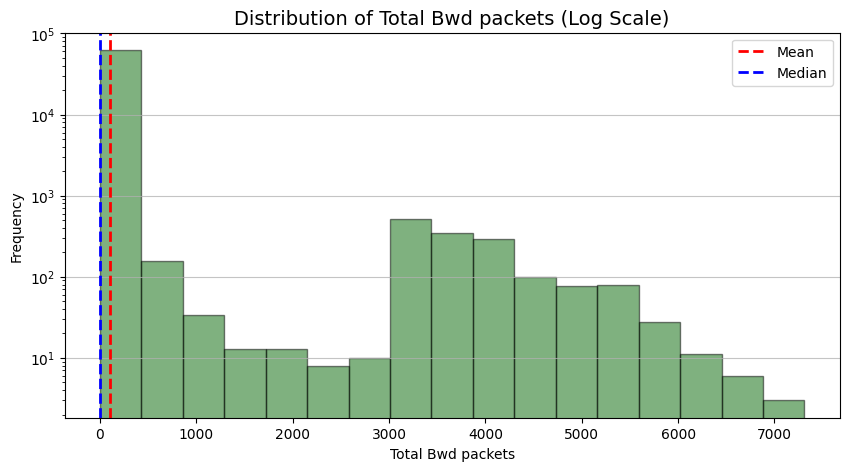

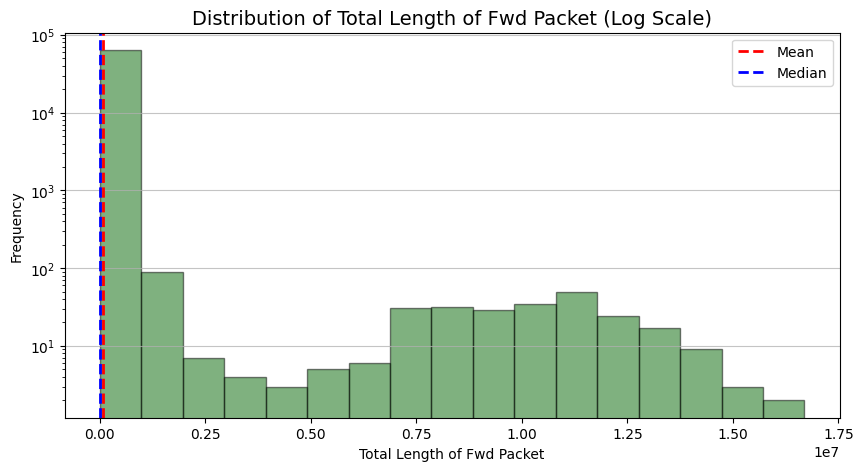

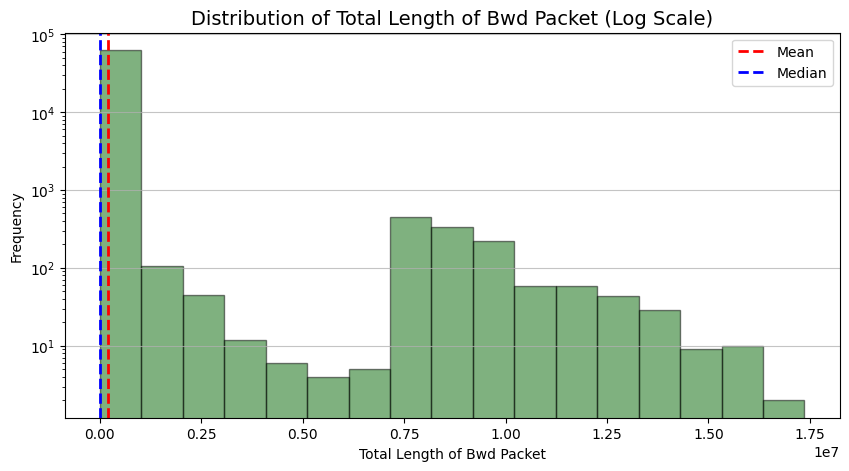

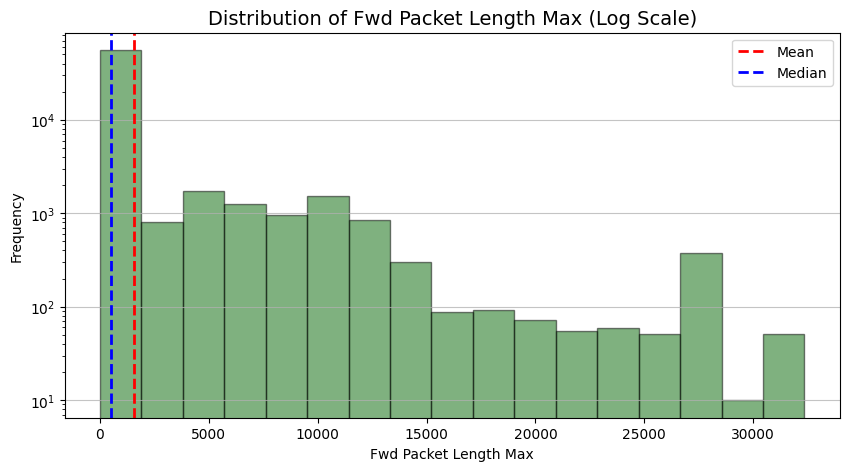

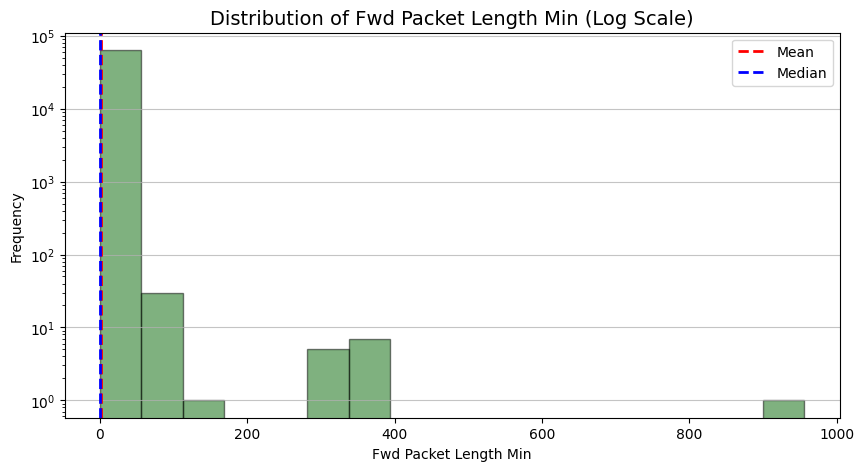

In [12]:
# Plot a histogram for each numerical variable to visually assess normality
print("\nGenerating histograms for each variable:")
for column in df.columns[:10]: 
    plt.figure(figsize=(10, 5))
    
    # Check skewness
    skew_val = df[column].skew()
    is_skewed = abs(skew_val) > 1
    
    # Plot
    if is_skewed:
        plt.hist(df[column], bins=num_bins, log=True, color='darkgreen', edgecolor='black', alpha=0.5)
        plt.title(f'Distribution of {column} (Log Scale)', fontsize=14)
        plt.ylabel('Frequency')
    else:
        plt.hist(df[column], bins=num_bins, log=False, color='darkgreen', edgecolor='black', alpha=0.5)
        plt.title(f'Distribution of {column} - Skew: {skew_val:.2f}', fontsize=14)
        plt.ylabel('Frequency')

    plt.xlabel(column)
    
    # Add mean/median lines
    plt.axvline(df[column].mean(), color='red', linestyle='--', linewidth=2, label='Mean')
    plt.axvline(df[column].median(), color='blue', linestyle='--', linewidth=2, label='Median')
    
    plt.legend()
    plt.grid(axis='y', alpha=0.75)
    plt.show()

### Analyzing correlations

Calculating correlation matrices...

Pearson Correlation Matrix Heatmap:


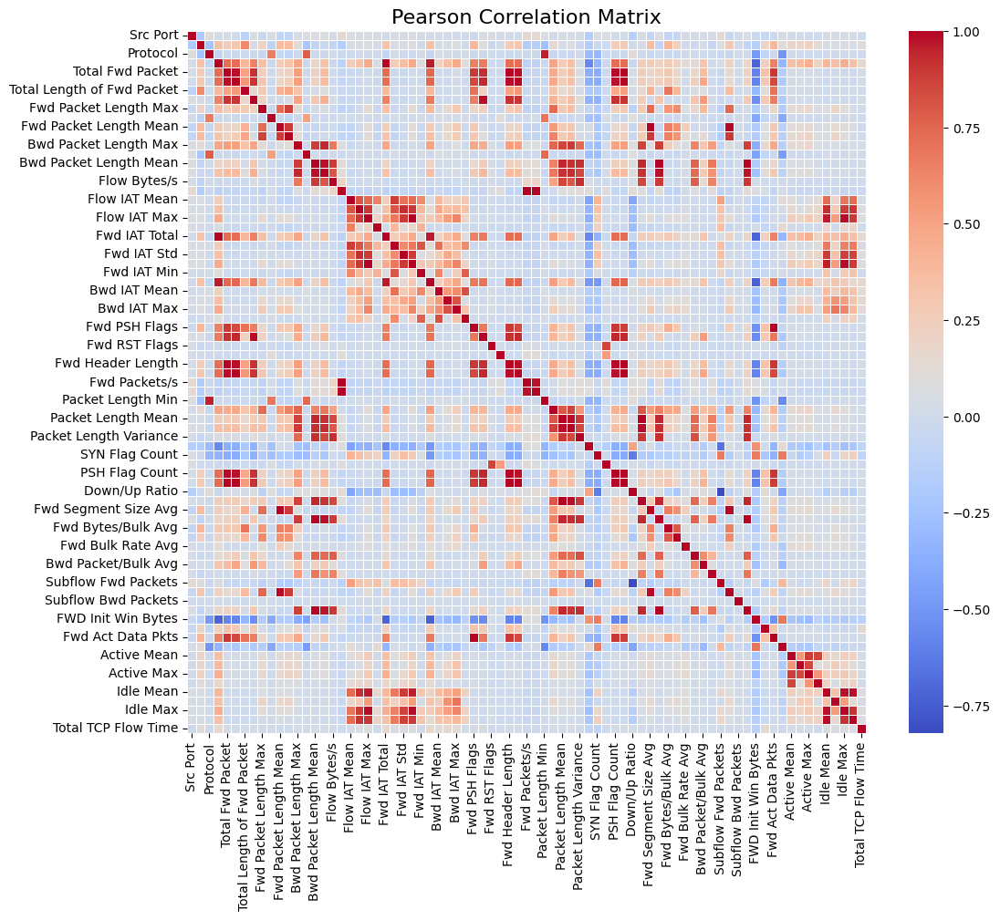


Spearman Correlation Matrix Heatmap:


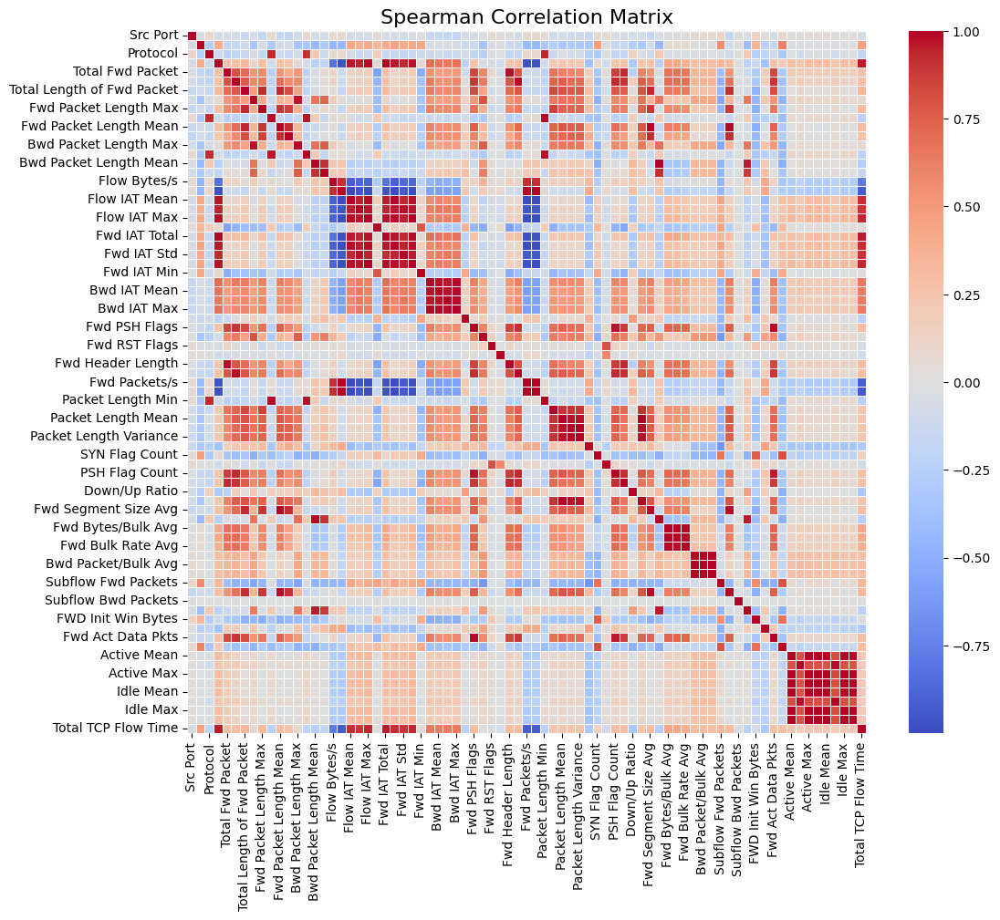

In [13]:
# Calculate Pearson and Spearman correlation matrices
print("Calculating correlation matrices...")
pearson_corr = df.corr(method='pearson')
spearman_corr = df.corr(method='spearman')

# Visualize the Pearson correlation matrix
print("\nPearson Correlation Matrix Heatmap:")
plt.figure(figsize=(12, 10))
sns.heatmap(pearson_corr, annot=False, fmt='.2f', cmap='coolwarm', linewidths=.5)
plt.title('Pearson Correlation Matrix', fontsize=16)
plt.show()

# Visualize the Spearman correlation matrix
print("\nSpearman Correlation Matrix Heatmap:")
plt.figure(figsize=(12, 10))
sns.heatmap(spearman_corr, annot=False, fmt='.2f', cmap='coolwarm', linewidths=.5)
plt.title('Spearman Correlation Matrix', fontsize=16)
plt.show()

### Analyzing suitability for factorization

In [14]:
# Perform Bartlett's Test of Sphericity
print("Performing Bartlett's Test of Sphericity...")

chi_square_value, p_value = calculate_bartlett_sphericity(df)
print(f"  Chi-Square Value: {chi_square_value:.2f}")
print(f"  P-value: {p_value}")

if p_value < 0.05:
    print("Result: The p-value is less than 0.05. We reject the null hypothesis.")
    print("Conclusion: The variables are correlated, and the data is suitable for factor analysis.")
else:
    print("Result: The p-value is greater than 0.05. We fail to reject the null hypothesis.")
    print("Conclusion: The variables are not correlated enough for factor analysis.")

# Perform Kaiser-Meyer-Olkin Test
print("\nPerforming Kaiser-Meyer-Olkin Test...")

kmo_all, kmo_model = calculate_kmo(df)
print(f"  Overall KMO for the dataset: {kmo_model:.2f}")

if kmo_model > 0.5:
    print("Result: The overall KMO score is greater than 0.5.")
    print("Conclusion: The sampling adequacy is acceptable for factor analysis.")
else:
    print("Result: The overall KMO score is less than 0.5.")
    print("Conclusion: The sampling adequacy is not sufficient for factor analysis.")

print("\nKMO per variable:")
kmo_per_variable = pd.Series(kmo_all, index=df.columns)
print(kmo_per_variable)

Performing Bartlett's Test of Sphericity...
  Chi-Square Value: 26291015.75
  P-value: 0.0
Result: The p-value is less than 0.05. We reject the null hypothesis.
Conclusion: The variables are correlated, and the data is suitable for factor analysis.

Performing Kaiser-Meyer-Olkin Test...
  Overall KMO for the dataset: nan
Result: The overall KMO score is less than 0.5.
Conclusion: The sampling adequacy is not sufficient for factor analysis.

KMO per variable:
Src Port              NaN
Dst Port              NaN
Protocol              NaN
Flow Duration         NaN
Total Fwd Packet      NaN
                       ..
Idle Mean             NaN
Idle Std              NaN
Idle Max              NaN
Idle Min              NaN
Total TCP Flow Time   NaN
Length: 77, dtype: float64


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\numpy\linalg\_linalg.py:2431: RuntimeWarning: overflow encountered in det
  r = _umath_linalg.det(a, signature=signature)
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\factor_analyzer\utils.py:199: RuntimeWarning: invalid value encountered in sqrt
  Is = np.sqrt(1 / np.diag(m))


### Normalizing the dataset

In [15]:
# Create a StandardScaler object
scaler = StandardScaler()

# Fit the scaler to the data and transform it
scaled_data = scaler.fit_transform(df)

# Convert the scaled NumPy array back to a pandas DataFrame
df_scaled = pd.DataFrame(scaled_data, columns=df.columns)

# Display the first few rows of the standardized data
print("First 5 rows of the standardized dataset:")
print(df_scaled.head())

# Verify the standardization by checking the mean and standard deviation
print("\nVerification of standardization:")
print("Mean of each column:")
print(df_scaled.mean())
print("\nStandard deviation of each column:")
print(df_scaled.std())

First 5 rows of the standardized dataset:
   Src Port  Dst Port  Protocol  Flow Duration  Total Fwd Packet  \
0  1.165260  0.055352 -0.126691      -0.284231         -0.182094   
1  0.293795  0.055352 -0.126691      -0.287270         -0.182094   
2 -0.976361  0.055352 -0.126691      -0.286678         -0.183537   
3  0.685133  0.055352 -0.126691       4.523215          7.675358   
4 -1.622753  0.055352 -0.126691      -0.247200         -0.098397   

   Total Bwd packets  Total Length of Fwd Packet  Total Length of Bwd Packet  \
0          -0.174140                   -0.104159                   -0.146664   
1          -0.174140                   -0.104117                   -0.146664   
2          -0.174140                   -0.104139                   -0.146664   
3           6.348922                    0.876876                    7.123725   
4          -0.120493                   -0.030573                   -0.146664   

   Fwd Packet Length Max  Fwd Packet Length Min  ...  Fwd Seg Size M

### Determining the optimal number of factors

In [16]:
# Perform initial Factor Analysis to get eigenvalues
fa_initial = FactorAnalyzer(method='principal', rotation=None, n_factors=df_scaled.shape[1])
fa_initial.fit(df_scaled)

# Get the eigenvalues from the fitted model
eigenvalues, _ = fa_initial.get_eigenvalues()

# Create a DataFrame to display the results clearly
eigenvalue_df = pd.DataFrame({
    'Factor': range(1, len(eigenvalues) + 1),
    'Eigenvalue': eigenvalues,
    'Variance Explained (%)': fa_initial.get_factor_variance()[1] * 100,
    'Cumulative Variance (%)': fa_initial.get_factor_variance()[2] * 100
})

print("Eigenvalues and Variance explained by Each Factor:")
print(eigenvalue_df.to_string())

c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Eigenvalues and Variance explained by Each Factor:
    Factor    Eigenvalue  Variance Explained (%)  Cumulative Variance (%)
0        1  1.626737e+01            2.112646e+01                21.126460
1        2  1.032678e+01            1.341140e+01                34.537859
2        3  8.614336e+00            1.118745e+01                45.725309
3        4  5.968165e+00            7.750863e+00                53.476172
4        5  4.616334e+00            5.995239e+00                59.471411
5        6  3.264024e+00            4.238992e+00                63.710403
6        7  3.033071e+00            3.939053e+00                67.649456
7        8  2.721384e+00            3.534265e+00                71.183721
8        9  2.245825e+00            2.916656e+00                74.100376
9       10  2.022985e+00            2.627253e+00                76.727630
10      11  1.888395e+00            2.452460e+00                79.180090
11      12  1.715036e+00            2.227319e+00             

In [17]:
# Kaiser's Criterion
kaiser_factors = sum(eigenvalues > 1)
print(f"Number of factors to retain based on Kaiser's Criterion (Eigenvalue > 1): {kaiser_factors}")

Number of factors to retain based on Kaiser's Criterion (Eigenvalue > 1): 17


Number of factors to explain at least 75.0% of variance: 10


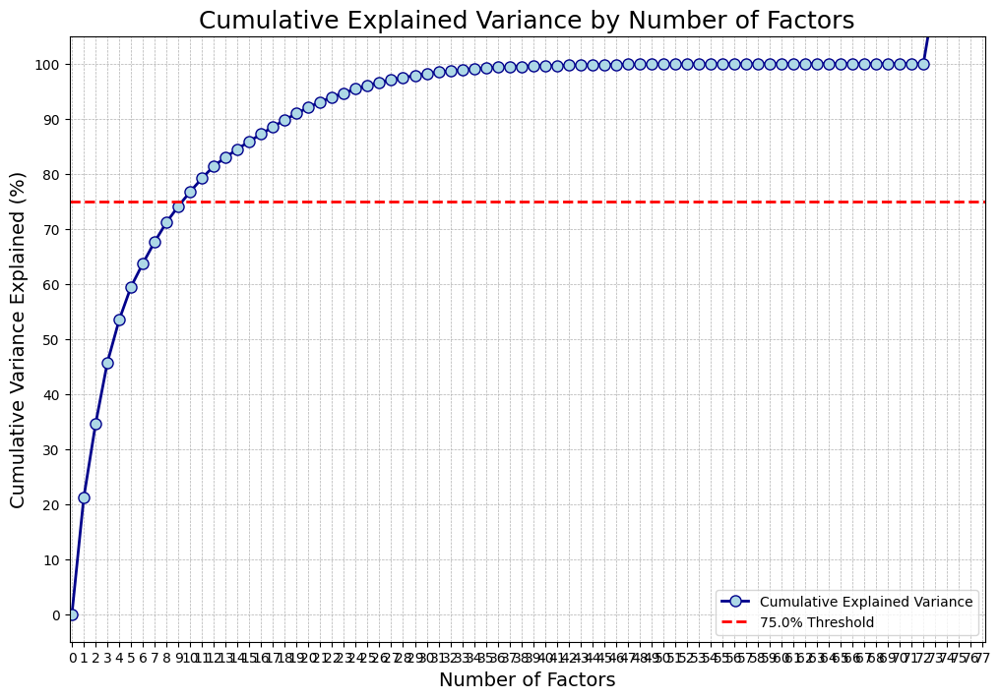

In [18]:
# Explained Variance Criterion
variance_threshold = 75.0
explained_variance_factors = (eigenvalue_df['Cumulative Variance (%)'] >= variance_threshold).idxmax() + 1
print(f"Number of factors to explain at least {variance_threshold}% of variance: {explained_variance_factors}")

# Cumulative Variance Plot
plt.figure(figsize=(12, 8))

# Prepare data for plotting
x_values = np.concatenate(([0], eigenvalue_df['Factor'].values))
y_values = np.concatenate(([0], eigenvalue_df['Cumulative Variance (%)'].values))

# Plot the cumulative variance line
plt.plot(
    x_values, 
    y_values, 
    'o-', 
    color='darkblue', 
    markersize=8, 
    linewidth=2,
    markerfacecolor='lightblue',
    label='Cumulative Explained Variance'
)

# Add the threshold line for reference
plt.axhline(y=variance_threshold, color='red', linestyle='--', linewidth=2, label=f'{variance_threshold}% Threshold')

# Set titles and labels for clarity
plt.title('Cumulative Explained Variance by Number of Factors', fontsize=18)
plt.xlabel('Number of Factors', fontsize=14)
plt.ylabel('Cumulative Variance Explained (%)', fontsize=14)

# Set axis limits with padding
plt.xlim(-0.2, df_scaled.shape[1] + 0.2)
plt.ylim(-5, 105)
plt.xticks(np.arange(0, df_scaled.shape[1] + 1, 1))
plt.yticks(np.arange(0, 101, 10))

# Add grid and legend
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend(loc='lower right')

# Show the plot
plt.show()

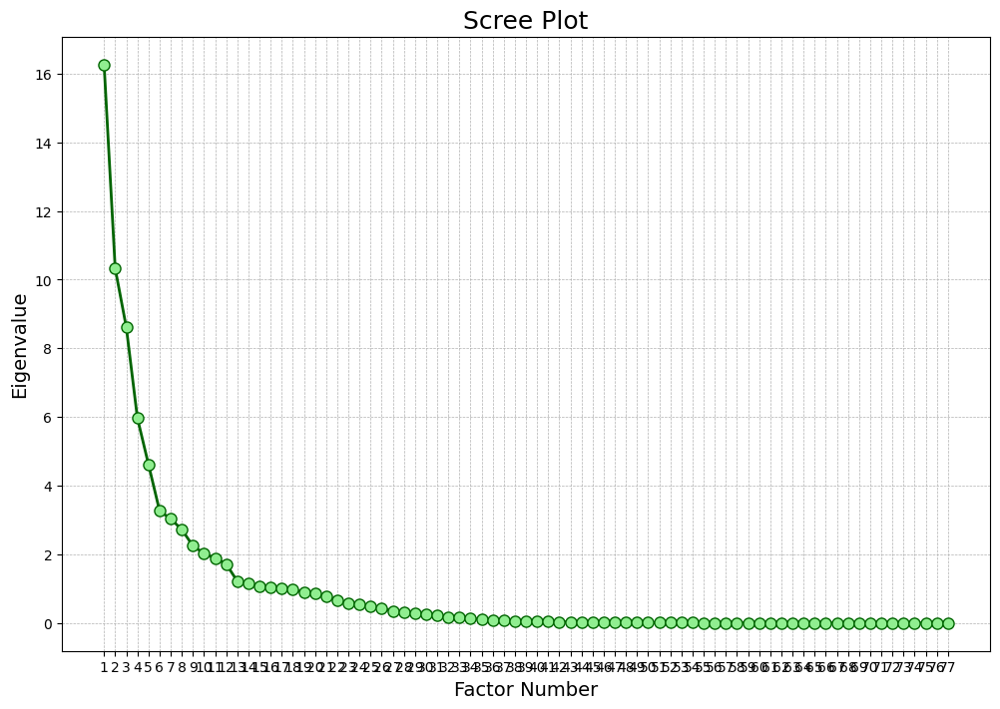

In [19]:
# Scree Plot
plt.figure(figsize=(12, 8))

# Plotting the eigenvalues
plt.plot(
    eigenvalue_df['Factor'], 
    eigenvalue_df['Eigenvalue'], 
    'o-',
    color='darkgreen', 
    markersize=8, 
    linewidth=2, 
    markerfacecolor='lightgreen',
    label='Eigenvalues'
)

plt.title('Scree Plot', fontsize=18)
plt.xlabel('Factor Number', fontsize=14)
plt.ylabel('Eigenvalue', fontsize=14)
plt.xticks(eigenvalue_df['Factor'])
plt.grid(True, which='both', linestyle='--', linewidth=0.5)

### Perform the factorization

In [20]:
# Define the final number of factors based on the analysis
final_n_factors = 11

c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


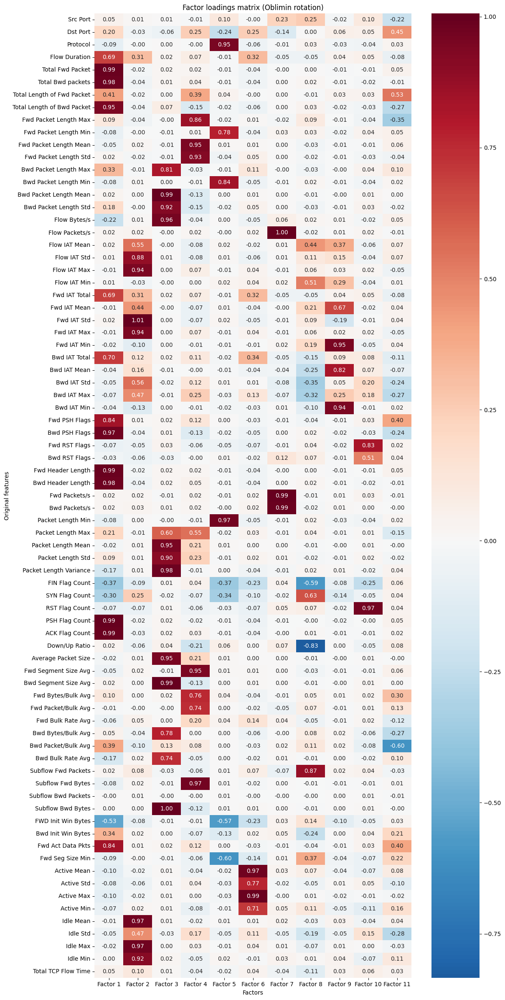

In [21]:
# Perform Factor Analysis
fa = FactorAnalyzer(n_factors=final_n_factors, method='principal', rotation='oblimin')
fa.fit(df_scaled)

# Get the factor loadings
loadings_df = pd.DataFrame(
    fa.loadings_, 
    index=df_scaled.columns, 
    columns=[f'Factor {i+1}' for i in range(final_n_factors)]
)

# Visualize Factor Loadings
plt.figure(figsize=(12, 24))
sns.heatmap(loadings_df, cmap='RdBu_r', center=0, annot=True, fmt='.2f')
plt.title(f'Factor loadings matrix (Oblimin rotation)')
plt.xlabel('Factors')
plt.ylabel('Original features')
plt.tight_layout()
plt.show()

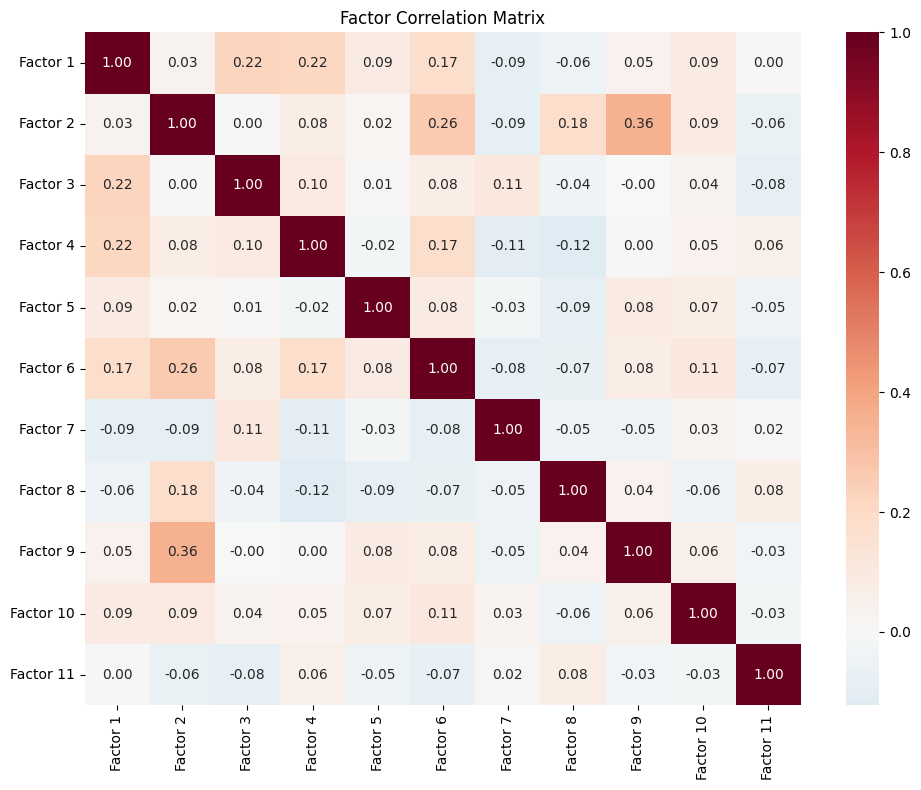

In [22]:
# Extract and visualize factor correlations
if fa.phi_ is not None:
    factor_corr_df = pd.DataFrame(
        fa.phi_,
        columns=[f'Factor {i+1}' for i in range(final_n_factors)],
        index=[f'Factor {i+1}' for i in range(final_n_factors)]
    )
    
    plt.figure(figsize=(10, 8))
    sns.heatmap(factor_corr_df, cmap='RdBu_r', center=0, annot=True, fmt='.2f')
    plt.title('Factor Correlation Matrix')
    plt.tight_layout()
    plt.show()

In [23]:
# Calculate and display the communalities
communalities = fa.get_communalities()
communalities_df = pd.DataFrame(communalities, index=df_scaled.columns, columns=['Communalities'])

print("Proportion of variance in each variable accounted for by the factors (Communalities):")
print(communalities_df)

Proportion of variance in each variable accounted for by the factors (Communalities):
                     Communalities
Src Port                  0.186447
Dst Port                  0.460592
Protocol                  0.924584
Flow Duration             0.696720
Total Fwd Packet          0.983684
...                            ...
Idle Mean                 0.938962
Idle Std                  0.404765
Idle Max                  0.954099
Idle Min                  0.864725
Total TCP Flow Time       0.037002

[77 rows x 1 columns]


In [24]:
# Transform the dataset
X_reduced = fa.transform(df_scaled)
df_factors = pd.DataFrame(X_reduced, columns=[f'Factor_{i+1}' for i in range(final_n_factors)])

print("\nTransformation complete.")
print(f"Original shape: {df_scaled.shape}")
print(f"Reduced shape:  {df_factors.shape}")
print("\nFirst 5 rows of the reduced dataset (Factors):")
print(df_factors.head())


Transformation complete.
Original shape: (63776, 77)
Reduced shape:  (63776, 11)

First 5 rows of the reduced dataset (Factors):
   Factor_1  Factor_2  Factor_3  Factor_4  Factor_5  Factor_6  Factor_7  \
0 -0.187341 -0.176980 -0.150645 -0.303276 -0.145435 -0.151184 -0.250761   
1 -0.187502 -0.176103 -0.150016 -0.286691 -0.168717 -0.141809  0.206535   
2 -0.204895 -0.175741 -0.140951 -0.305440 -0.190606 -0.148525 -0.347772   
3  7.086379 -0.013748  1.376641 -0.502092  0.122758  0.342435 -0.289930   
4 -0.204939 -0.222107  0.075756  1.809687 -0.226541 -0.236376 -0.465656   

   Factor_8  Factor_9  Factor_10  Factor_11  
0 -0.119275 -0.107736  -0.137960  -0.064425  
1 -0.184052 -0.098917  -0.188425   0.035493  
2 -0.431591 -0.085396  -0.247310   0.193426  
3 -0.746476 -0.000899   0.617962   1.175923  
4  0.069562 -0.118218  -0.301643  -0.152918  


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


### Visualizing selected factors

In [25]:
# Prepare the data for visualization by combining factors with ground truth labels
df_plot = df_factors.copy()
df_plot['Label'] = ground_truth.values

# Create a smaller sample for plotting
n_samples = 8192
if len(df_plot) > n_samples:
    df_sample = df_plot.sample(n=n_samples, random_state=42)
else:
    df_sample = df_plot.copy()

print(f"Using a sample of {len(df_sample)} data points for visualization.")

# Get unique labels from the ground truth data
unique_labels = sorted(df_sample['Label'].unique())

# Create a custom color palette
palette = plt.cm.get_cmap('tab10', len(unique_labels))
color_map = {label: palette(i) for i, label in enumerate(unique_labels)}

# Set quantiles
lower_quantile, upper_quantile = 0.01, 0.92

Using a sample of 8192 data points for visualization.


C:\Users\kasht\AppData\Local\Temp\ipykernel_12192\3195512053.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  palette = plt.cm.get_cmap('tab10', len(unique_labels))


Generating pairplot for 'Categorized scatter plot matrix' using 8192 sample points...


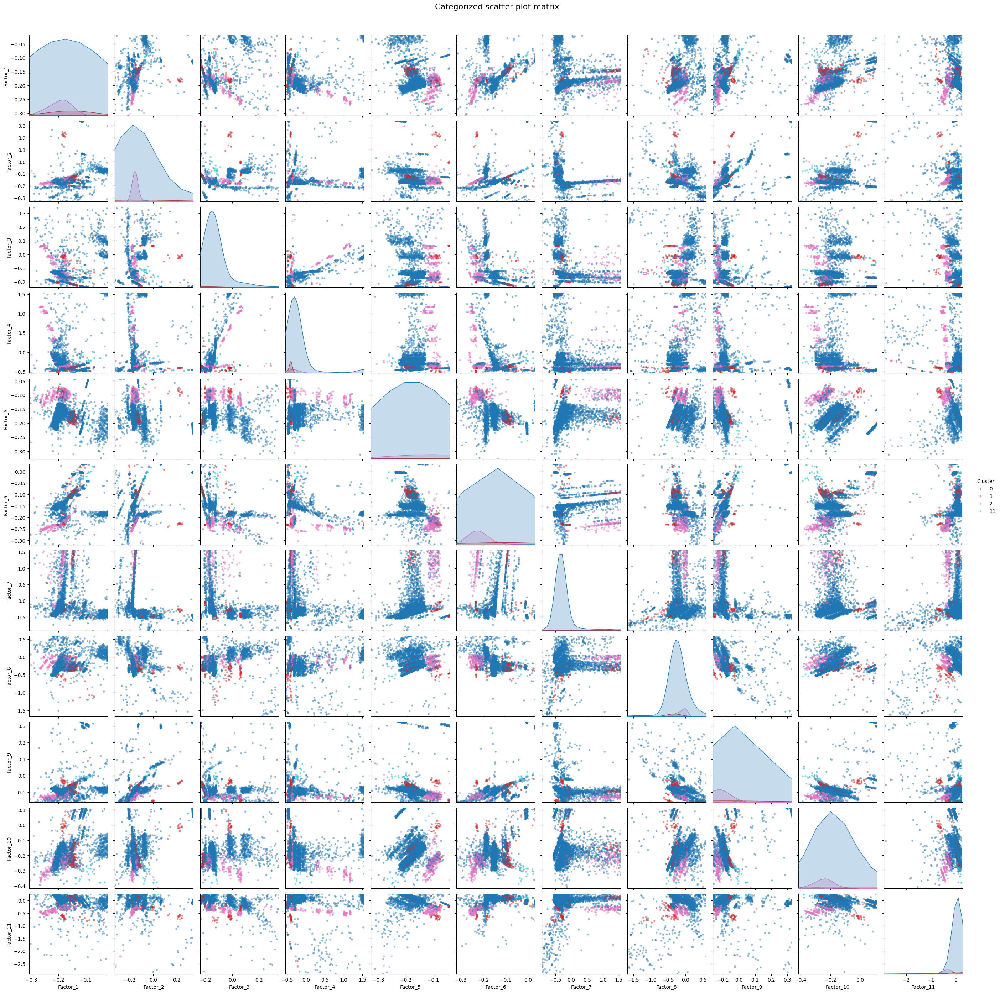

In [26]:
# Plot pairplot
plot_cluster_pairplot(df_factors, ground_truth.values, color_map, n_samples, lower_quantile, upper_quantile)

Generating detailed scatter plot for Factor_6 vs Factor_5...


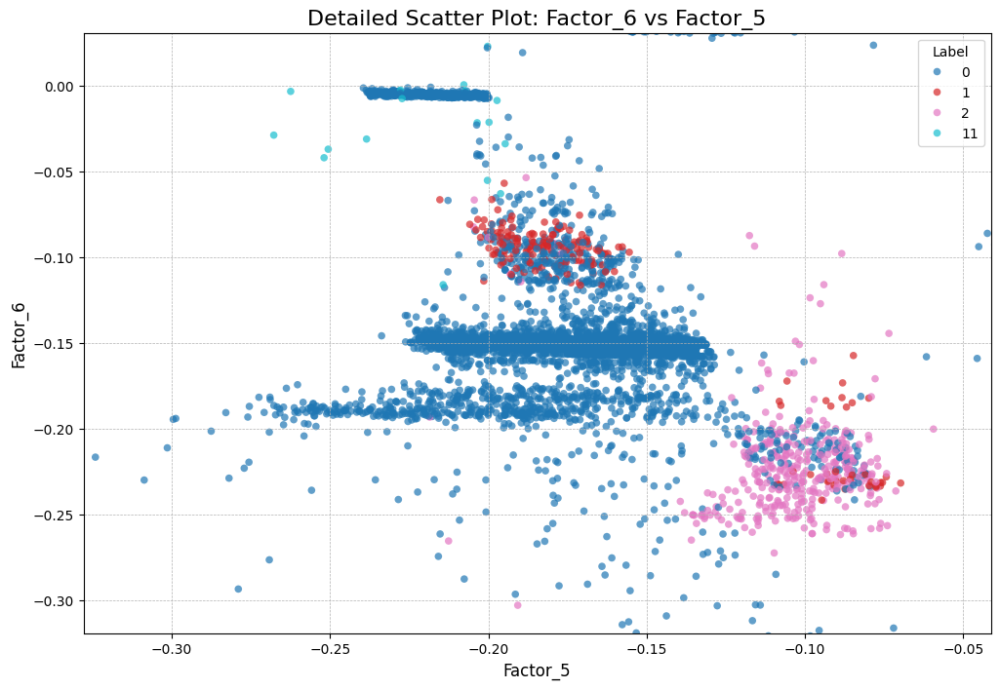

Generating detailed scatter plot for Factor_3 vs Factor_11...


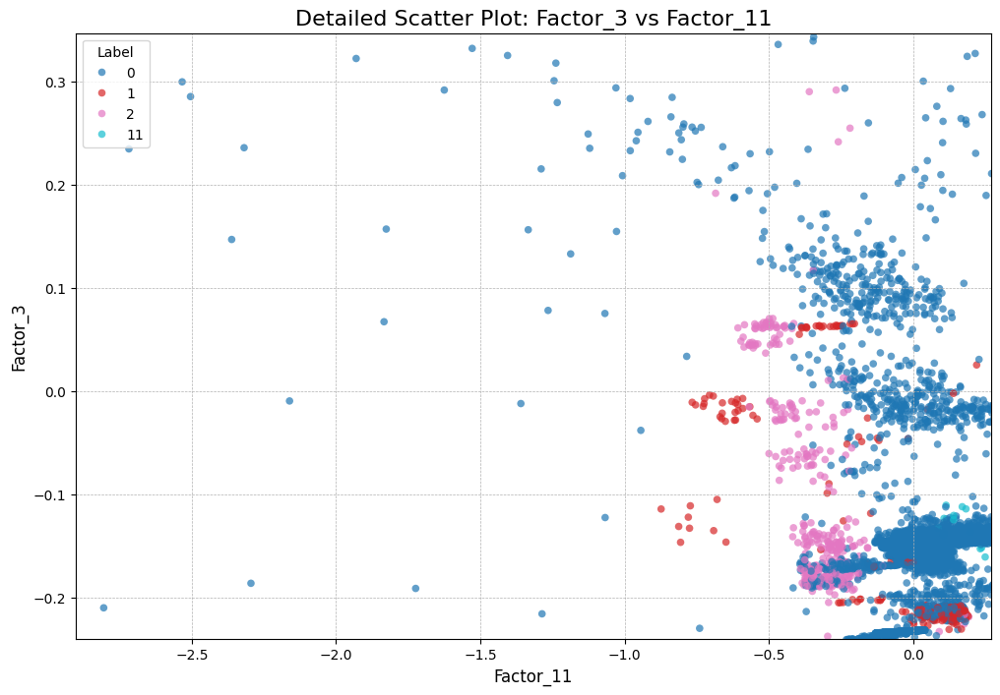

Generating detailed scatter plot for Factor_9 vs Factor_8...


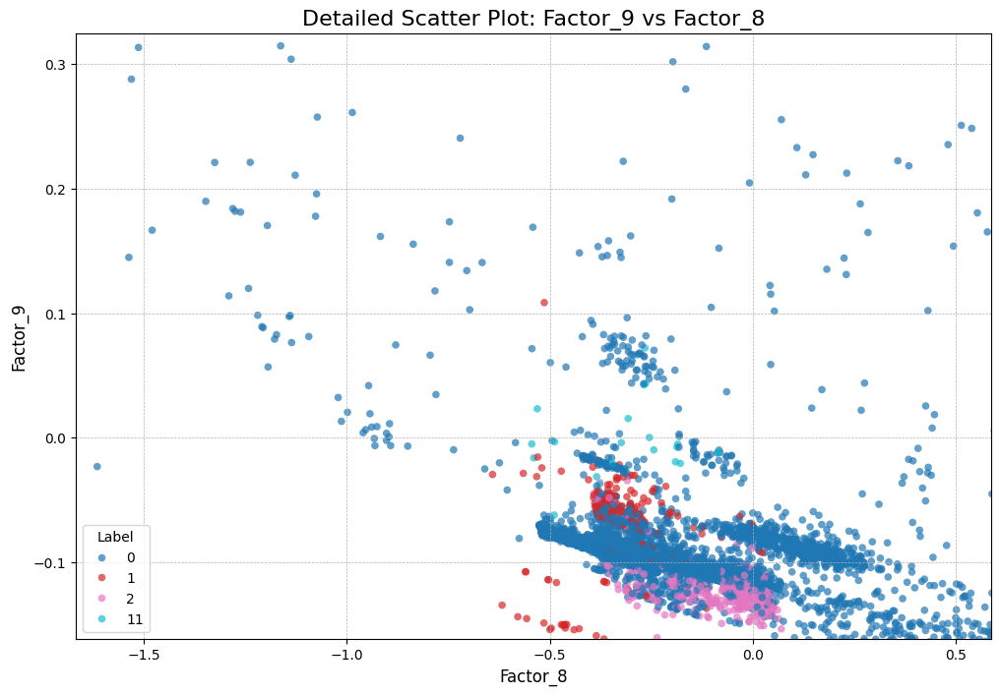

In [27]:
# Define the pairs of factors we want to visualize in detail
selected_pairs = [
    ('Factor_5', 'Factor_6'),
    ('Factor_11', 'Factor_3'),
    ('Factor_8', 'Factor_9')
]

# Loop through the selected pairs and create a plot for each
for x_factor, y_factor in selected_pairs:
    print(f"Generating detailed scatter plot for {y_factor} vs {x_factor}...")
    
    plt.figure(figsize=(12, 8))
    
    # Create the scatter plot using seaborn for better aesthetics
    sns.scatterplot(
        data=df_sample,
        x=x_factor,
        y=y_factor,
        hue='Label',
        palette=color_map,
        alpha=0.7,
        s=30,
        linewidth=0
    )
    
    x_min, x_max = df_sample[x_factor].quantile([lower_quantile, upper_quantile])
    y_min, y_max = df_sample[y_factor].quantile([lower_quantile, upper_quantile])
    
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    
    # Add title and grid
    plt.title(f'Detailed Scatter Plot: {y_factor} vs {x_factor}', fontsize=16)
    plt.xlabel(x_factor, fontsize=12)
    plt.ylabel(y_factor, fontsize=12)
    plt.grid(True, which='both', linestyle='--', linewidth=0.5)
    plt.legend(title='Label')
    plt.show()

Generating 3D plot for factors: Factor_1, Factor_2, Factor_3...


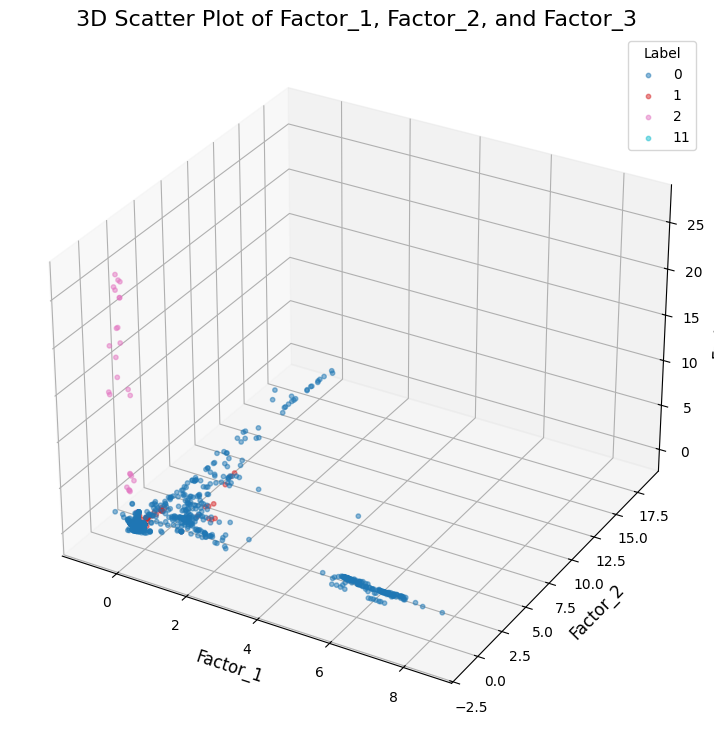

Generating 3D plot for factors: Factor_5, Factor_6, Factor_1...


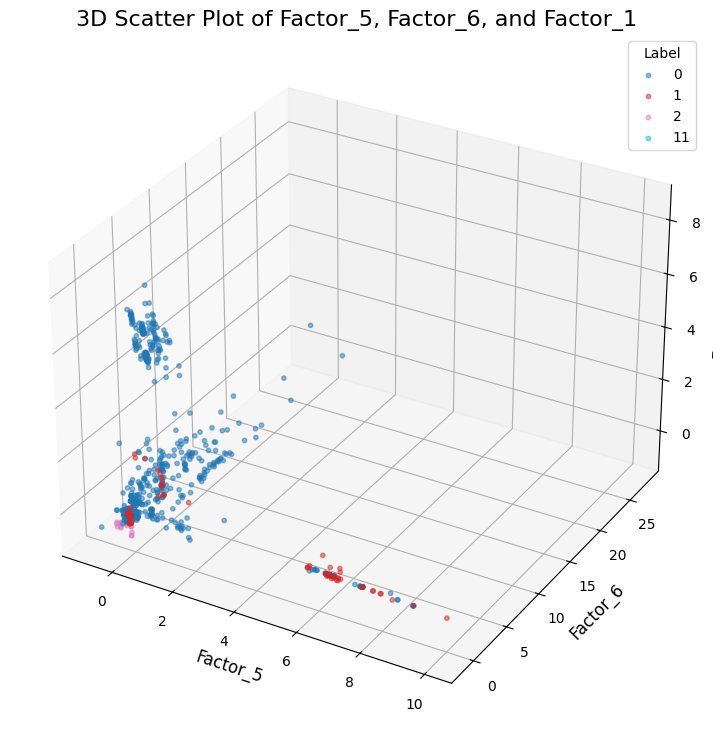

Generating 3D plot for factors: Factor_8, Factor_9, Factor_11...


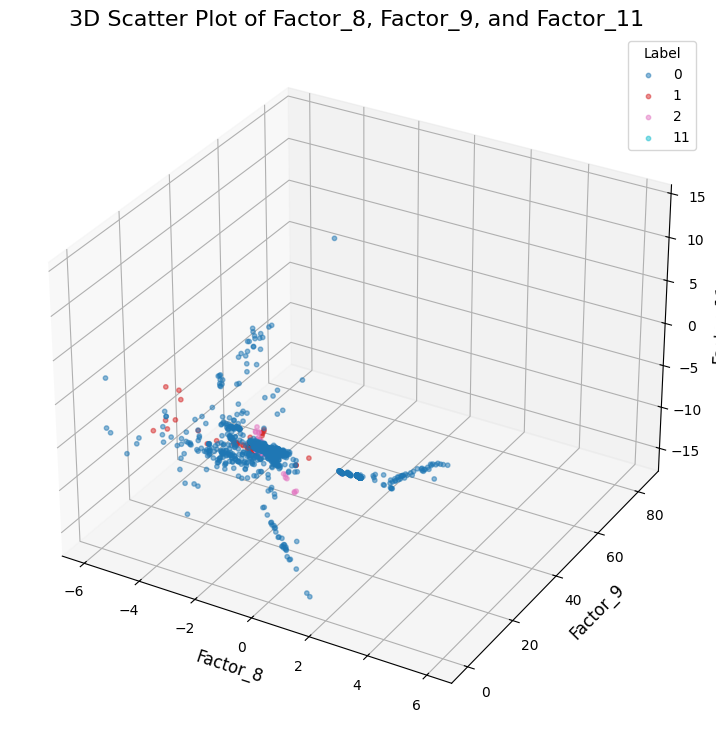

In [28]:
# Define the combinations of factors for 3D visualization
factor_combinations = [
    ('Factor_1', 'Factor_2', 'Factor_3'),
    ('Factor_5', 'Factor_6', 'Factor_1'),
    ('Factor_8', 'Factor_9', 'Factor_11')
]

# Loop through the combinations and create a 3D plot for each
for x_factor, y_factor, z_factor in factor_combinations:
    print(f"Generating 3D plot for factors: {x_factor}, {y_factor}, {z_factor}...")
    
    # Create a new figure and a 3D subplot
    fig = plt.figure(figsize=(12, 9))
    ax = fig.add_subplot(111, projection='3d')

    # Plot each label group with its corresponding color
    for label, color in color_map.items():
        subset = df_sample[df_sample['Label'] == label]
        ax.scatter(
            subset[x_factor], 
            subset[y_factor], 
            subset[z_factor], 
            c=[color], 
            label=label, 
            s=10, 
            alpha=0.5
        )

    # Set labels and title dynamically
    ax.set_xlabel(x_factor, fontsize=12)
    ax.set_ylabel(y_factor, fontsize=12)
    ax.set_zlabel(z_factor, fontsize=12)
    ax.set_title(f'3D Scatter Plot of {x_factor}, {y_factor}, and {z_factor}', fontsize=16)
    ax.legend(title='Label')
    
    plt.show()

### Finding optimal parameters

Calculating inertia for k in [2, 15]...
  k=2, Inertia: 648377.11
  k=3, Inertia: 572707.11
  k=4, Inertia: 529570.77
  k=5, Inertia: 484930.11
  k=6, Inertia: 437839.34
  k=7, Inertia: 386156.36
  k=8, Inertia: 324173.38
  k=9, Inertia: 284491.83
  k=10, Inertia: 250299.67
  k=11, Inertia: 229696.79
  k=12, Inertia: 183400.51
  k=13, Inertia: 168524.65
  k=14, Inertia: 139528.54
  k=15, Inertia: 119948.28


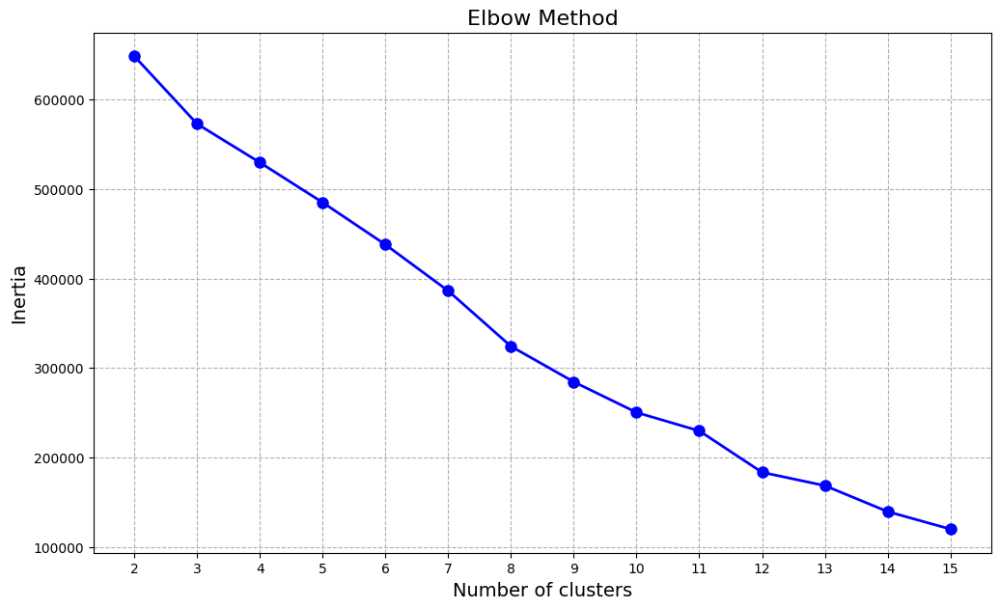

In [29]:
# Define the range of clusters to test
k_range = range(2, 16)
inertia_values = []

print("Calculating inertia for k in [2, 15]...")

# Loop through each number of clusters
for k in k_range:
    # Instantiate and fit the K-Means model
    kmeans_model = KMeans(n_clusters=k, n_init='auto', random_state=42)
    kmeans_model.fit(df_factors)
    
    # Append the inertia to our list
    inertia_values.append(kmeans_model.inertia_)
    print(f"  k={k}, Inertia: {kmeans_model.inertia_:.2f}")

# Plot the results
plt.figure(figsize=(12, 7))
plt.plot(k_range, inertia_values, 'bo-', markersize=8, linewidth=2)
plt.xlabel('Number of clusters', fontsize=14)
plt.ylabel('Inertia', fontsize=14)
plt.title('Elbow Method', fontsize=16)
plt.grid(True, linestyle='--')
plt.xticks(k_range)
plt.show()

In [30]:
# Create a smaller subsample for the analysis
if len(df_factors) > n_samples:
    df_factors_sample = df_factors.sample(n=n_samples, random_state=42)
    print(f"Using a random subsample of {n_samples} data points for silhouette analysis.")
else:
    df_factors_sample = df_factors.copy()
    print("Dataset is smaller than the sample size; using the full dataset for silhouette analysis.")

Using a random subsample of 8192 data points for silhouette analysis.


Calculating average silhouette scores on the subsample for k in [2, 15]...
  k=2, Average Silhouette Score: 0.7404
  k=3, Average Silhouette Score: 0.7345
  k=4, Average Silhouette Score: 0.7345
  k=5, Average Silhouette Score: 0.7383
  k=6, Average Silhouette Score: 0.7339
  k=7, Average Silhouette Score: 0.7310
  k=8, Average Silhouette Score: 0.5645
  k=9, Average Silhouette Score: 0.5717
  k=10, Average Silhouette Score: 0.5773
  k=11, Average Silhouette Score: 0.6281
  k=12, Average Silhouette Score: 0.6669
  k=13, Average Silhouette Score: 0.7168
  k=14, Average Silhouette Score: 0.7132
  k=15, Average Silhouette Score: 0.7192


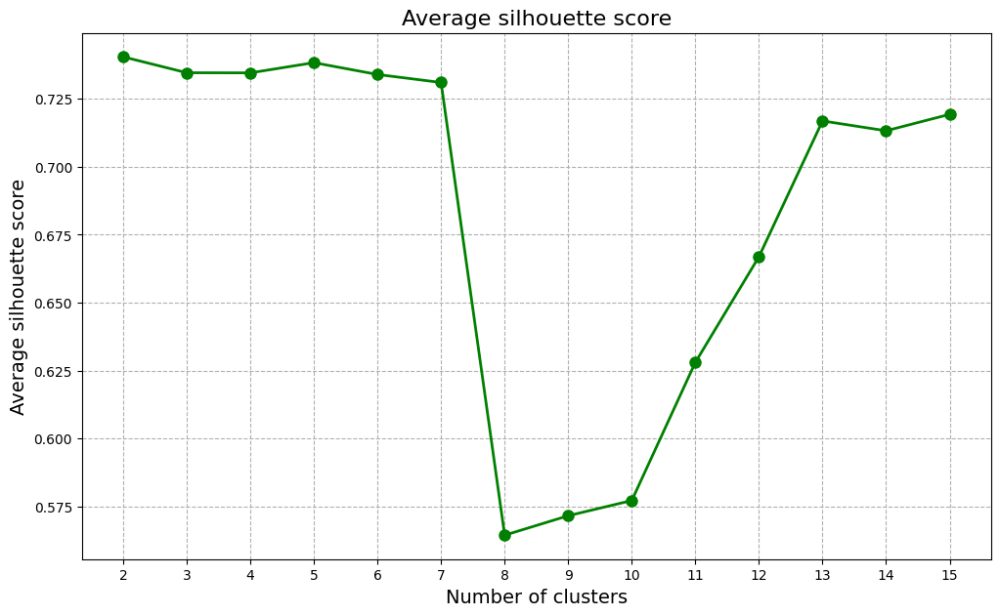

In [31]:
# Plotting average silhouette scores
k_range = range(2, 16)
average_silhouette_scores = []

print("Calculating average silhouette scores on the subsample for k in [2, 15]...")

for k in k_range:
    # Use the subsample for fitting the model
    kmeans_model = KMeans(n_clusters=k, n_init='auto', random_state=42)
    labels = kmeans_model.fit_predict(df_factors_sample)
    
    # Calculate score based on the subsample
    score = silhouette_score(df_factors_sample, labels)
    average_silhouette_scores.append(score)
    print(f"  k={k}, Average Silhouette Score: {score:.4f}")

plt.figure(figsize=(12, 7))
plt.plot(k_range, average_silhouette_scores, 'go-', markersize=8, linewidth=2)
plt.xlabel('Number of clusters', fontsize=14)
plt.ylabel('Average silhouette score', fontsize=14)
plt.title('Average silhouette score', fontsize=16)
plt.grid(True, linestyle='--')
plt.xticks(k_range)
plt.show()

In [32]:
class GapStatistics:
    def __init__(self,
                 algorithm: Callable = KMeans,
                 distance_metric: str = 'euclidean',
                 pca_sampling: bool = True,
                 return_params: bool = False):

        if isinstance(distance_metric, str):
            self.distance_metric = lambda X, Y: pairwise_distances(X, Y, metric=distance_metric)
        elif callable(distance_metric):
            self.distance_metric = distance_metric
        else:
            raise TypeError(
                "distance_metric must be either a string or a function")
        if not isinstance(pca_sampling, bool):
            raise TypeError('Please provide a bool for pca_sampling')
        if not isinstance(return_params, bool):
            raise TypeError('Please provide a bool for return_params')

        self.algorithm = algorithm
        self.pca_sampling = pca_sampling
        self.return_params = return_params

    def _calculate_Wks(self, K: int, X: np.ndarray) -> list:
        Wks = []
        for k in np.arange(1, K+1):
            try:
                model = self.algorithm(n_clusters=k, n_init='auto', random_state=42).fit(X)
                labels = model.labels_
                centroids = model.cluster_centers_
            except Exception as e:
                print(
                    'You have some problems with your customized provided clustering algorithm ', e)
                continue

            Ds = []
            for i in range(k):
                cluster_array = np.array(X[labels == i])
                d = self.distance_metric(
                    cluster_array, centroids[i].reshape(1, -1))
                Ds.append(np.sum(d))

            Wk = np.sum(Ds) / (2 * len(X))
            Wks.append(Wk)
        return Wks

    def _simulate_Wks(self, X: np.ndarray, K: int, n_iterations: int) -> np.ndarray:
        if self.pca_sampling:
            scaler = StandardScaler()
            scaled_X = scaler.fit_transform(X)
            _, _, VT = svd(scaled_X)  # U, D, VT
            X_prime = np.dot(X, VT.T)
        else:
            X_prime = X

        simulated_Wks = []

        for _ in range(n_iterations):
            Z_prime = np.random.uniform(
                np.min(X_prime, axis=0), np.max(X_prime, axis=0), size=(len(X), X.shape[1]))

            if self.pca_sampling:
                sampled_X = np.dot(Z_prime, VT)
            else:
                sampled_X = Z_prime

            Wks_star = self._calculate_Wks(K=K, X=sampled_X)
            simulated_Wks.append(Wks_star)

        sim_Wks = np.array(simulated_Wks)
        return sim_Wks

    def fit_predict(self, K: int, X: np.ndarray, n_iterations: int = 20):
        if not isinstance(K, int):
            raise TypeError('K must be of type int')
        if K > len(X):
            raise Exception('K must be smaller than the length of X')
        if not isinstance(n_iterations, int):
            raise TypeError('n_iterations must be of type int')
        if n_iterations > 500:
            raise Exception('n_iterations is too big, choose below 500')
        if isinstance(X, list):
            X = np.array(X)
        elif isinstance(X, np.ndarray):
            pass
        else:
            raise TypeError(
                'Please provide either a list or a numpy array for X')

        Wks = self._calculate_Wks(K=K, X=X)
        sim_Wks = self._simulate_Wks(K=K, X=X, n_iterations=n_iterations)

        log_Wks = np.log(Wks)
        log_Wks_star = np.log(sim_Wks)

        sd_k = np.std(log_Wks_star, axis=0)
        self.sim_sks = np.sqrt(1 + (1 / n_iterations)) * sd_k

        self.gaps = np.mean(log_Wks_star, axis=0) - log_Wks

        optimum = 1
        for i in range(0, len(self.gaps) - 1):
            if self.gaps[i] >= self.gaps[i+1] - self.sim_sks[i+1]:
                optimum = i + 1
                break

        self.optimum = optimum
        
        return optimum

print("Custom class 'GapStatistics' is defined.")

Custom class 'GapStatistics' is defined.


Calculating GAP statistic on a subsample of 8192 data points...

Optimal number of clusters found by GAP statistic: 2


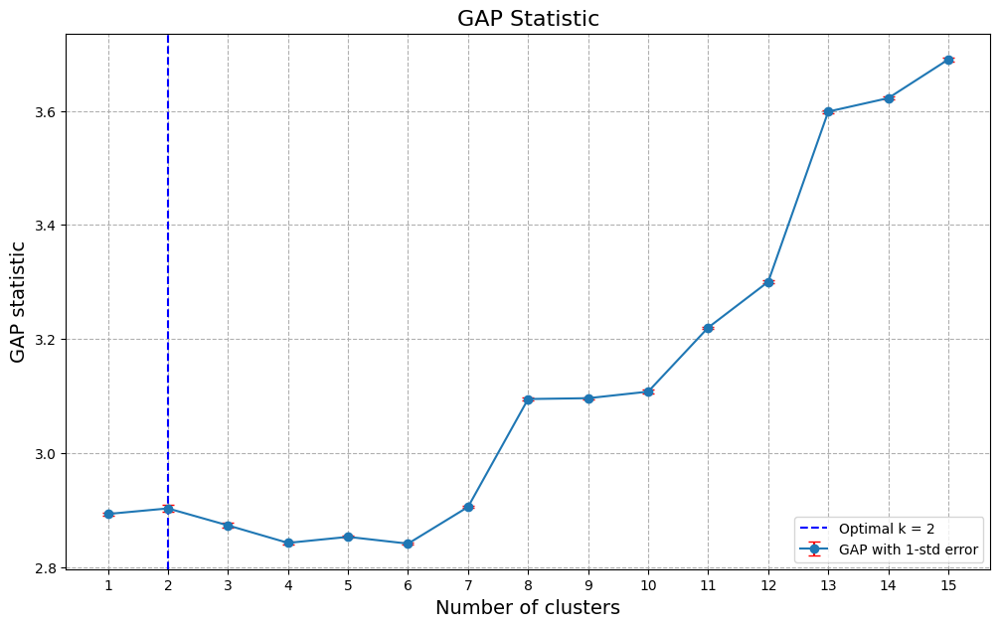

In [33]:
print(f"Calculating GAP statistic on a subsample of {len(df_factors_sample)} data points...")

# Instantiate the class
gap_stat = GapStatistics()

# Run the calculation.
max_k = 15
optimal_k = gap_stat.fit_predict(K=max_k, X=df_factors_sample.to_numpy())

print(f"\nOptimal number of clusters found by GAP statistic: {optimal_k}")

# Plot the results manually since the built-in plot is for 2D data
k_values = np.arange(1, max_k + 1)
gaps = gap_stat.gaps
stdevs = gap_stat.sim_sks

plt.figure(figsize=(12, 7))
plt.errorbar(k_values, gaps, yerr=stdevs, fmt='o-', ecolor='red', capsize=4, label='GAP with 1-std error')
plt.axvline(optimal_k, linestyle='--', color='blue', label=f'Optimal k = {optimal_k}')

plt.xlabel('Number of clusters', fontsize=14)
plt.ylabel('GAP statistic', fontsize=14)
plt.title('GAP Statistic', fontsize=16)
plt.grid(True, linestyle='--')
plt.xticks(k_values)
plt.legend()
plt.show()

### K-means method

In [34]:
# Define the optimal number of clusters
optimal_k_kmeans = 9
print(f"Initializing K-Means with k={optimal_k_kmeans} clusters.")

# Instantiate and fit the K-Means model
kmeans = KMeans(n_clusters=optimal_k_kmeans, n_init='auto', random_state=42)

# Fit the model to the factorized data and get the cluster labels for each data point
kmeans_labels = kmeans.fit_predict(df_factors)

# Display results
print("K-Means clustering complete.")
print(f"Number of data points: {len(kmeans_labels)}")
print(f"Unique cluster labels found: {np.unique(kmeans_labels)}")
print("\nFirst 20 cluster assignments:")
print(kmeans_labels[:20])

Initializing K-Means with k=9 clusters.
K-Means clustering complete.
Number of data points: 63776
Unique cluster labels found: [0 1 2 3 4 5 6 7 8]

First 20 cluster assignments:
[0 0 0 4 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 3]


In [35]:
# Calculate and print metrics
print("Calculating metrics for K-Means clustering...")
kmeans_metrics = calculate_and_print_metrics(
    data=df_factors,
    true_labels=ground_truth,
    predicted_labels=kmeans_labels
)

# Analyze and print cluster characteristics
print("Analyzing cluster characteristics for K-Means...")
analyze_clusters(
    data=df_factors, 
    labels=kmeans_labels, 
    model=kmeans
)

Calculating metrics for K-Means clustering...
External metrics:
- Rand Index (RI):           0.7626
- Adjusted Rand Index (ARI): 0.3966
- Jaccard Index:             0.7263

Internal metrics:
- Silhouette Score:        0.5597
- Compactness (WSS):       284491.8308
- Separation (BSS):        417043.2318
Analyzing cluster characteristics for K-Means...
Size of each cluster:
0    51125
1      138
2      336
3      246
4     1235
5     1240
6     1418
7     1258
8     6780
Name: count, dtype: int64
Cluster centers:
   Factor_1   Factor_2   Factor_3  Factor_4  Factor_5  Factor_6  Factor_7  \
0 -0.166827  -0.115945  -0.108275 -0.037798 -0.170045 -0.130624 -0.286709   
1 -0.510065  -0.145536  19.412636 -0.263012 -0.180211 -0.374949  2.622048   
2 -0.054179  10.123902  -0.146752 -0.869742 -0.271155  1.212363 -0.181876   
3  6.104045  -0.006962   0.837073  7.160250  0.654573  1.014195 -0.806580   
4  6.388635  -0.139162   1.560703 -0.005530  0.421913  0.426928 -0.436142   
5 -0.205287  -0.187163

c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\numpy\_core\fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


{'sizes': 0    51125
 1      138
 2      336
 3      246
 4     1235
 5     1240
 6     1418
 7     1258
 8     6780
 Name: count, dtype: int64,
 'centers':    Factor_1   Factor_2   Factor_3  Factor_4  Factor_5  Factor_6  Factor_7  \
 0 -0.166827  -0.115945  -0.108275 -0.037798 -0.170045 -0.130624 -0.286709   
 1 -0.510065  -0.145536  19.412636 -0.263012 -0.180211 -0.374949  2.622048   
 2 -0.054179  10.123902  -0.146752 -0.869742 -0.271155  1.212363 -0.181876   
 3  6.104045  -0.006962   0.837073  7.160250  0.654573  1.014195 -0.806580   
 4  6.388635  -0.139162   1.560703 -0.005530  0.421913  0.426928 -0.436142   
 5 -0.205287  -0.187163   0.146802 -0.451902 -0.023158 -0.154499  0.820406   
 6  0.564666   2.727641   0.465044  1.949258  0.358731  4.712759 -0.813596   
 7 -0.126414   0.046413  -0.140922 -0.451309  6.828804  0.052616 -0.166527   
 8 -0.171244  -0.143711   0.015979 -0.166601 -0.139108 -0.149190  2.277316   
 
    Factor_8  Factor_9  Factor_10  Factor_11  
 0  0.057273 -0

Generating silhouette plot for 'K-Means' (found 9 clusters)...
The average silhouette score for all clustered points is: 0.5597


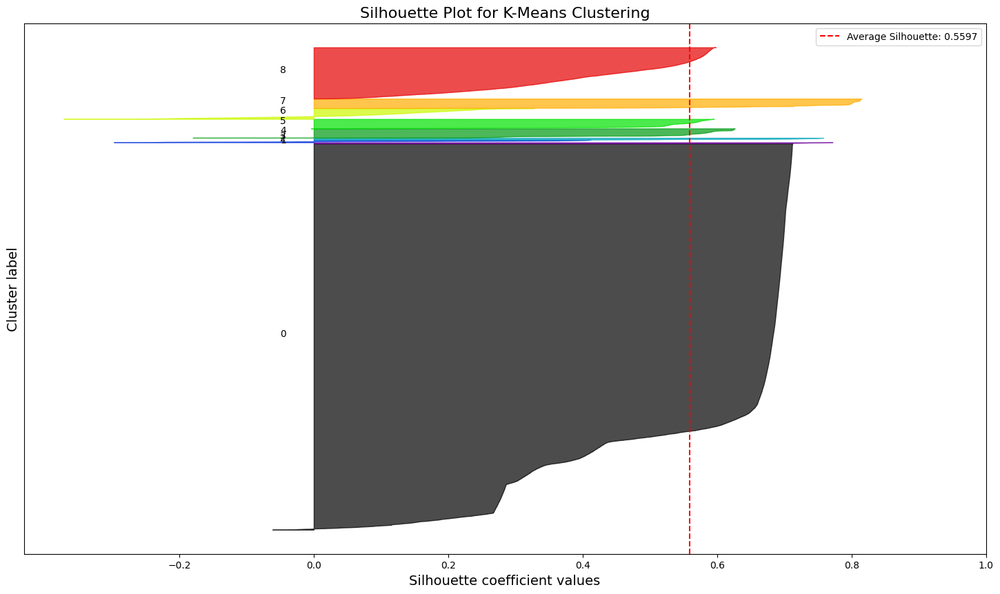

In [36]:
# Plot the silhouette diagram
plot_silhouette_diagram(
    data=df_factors,
    labels=kmeans_labels,
    model_name="K-Means"
)

Calculating feature importance for 'K-Means'...


<Figure size 1600x1200 with 0 Axes>

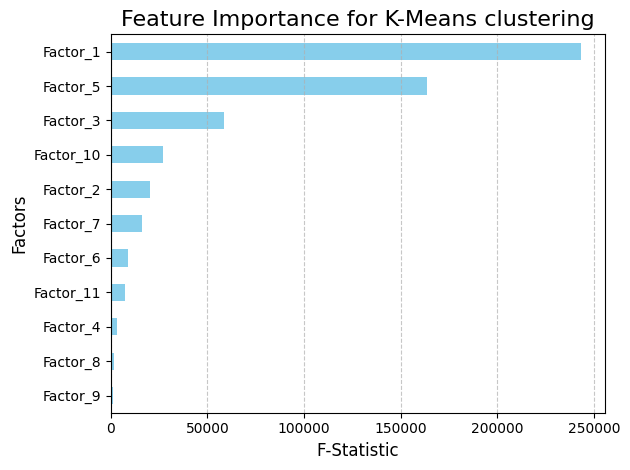

Feature importance ranking:
             F-Statistic
Factor_1   243561.885127
Factor_5   163468.996022
Factor_3    58712.311015
Factor_10   26916.813390
Factor_2    20447.551101
Factor_7    15952.998108
Factor_6     8842.788226
Factor_11    7227.431577
Factor_4     3391.069276
Factor_8     1555.086887
Factor_9     1044.593693


In [37]:
# Calculate and plot feature importance
kmeans_importance = plot_feature_importance(
    data=df_factors,
    labels=kmeans_labels,
    model_name="K-Means"
)
if kmeans_importance is not None:
    print("Feature importance ranking:")
    print(kmeans_importance)

Generating pairplot for 'K-Means clustering categorized scatter plot matrix' using 8192 sample points...


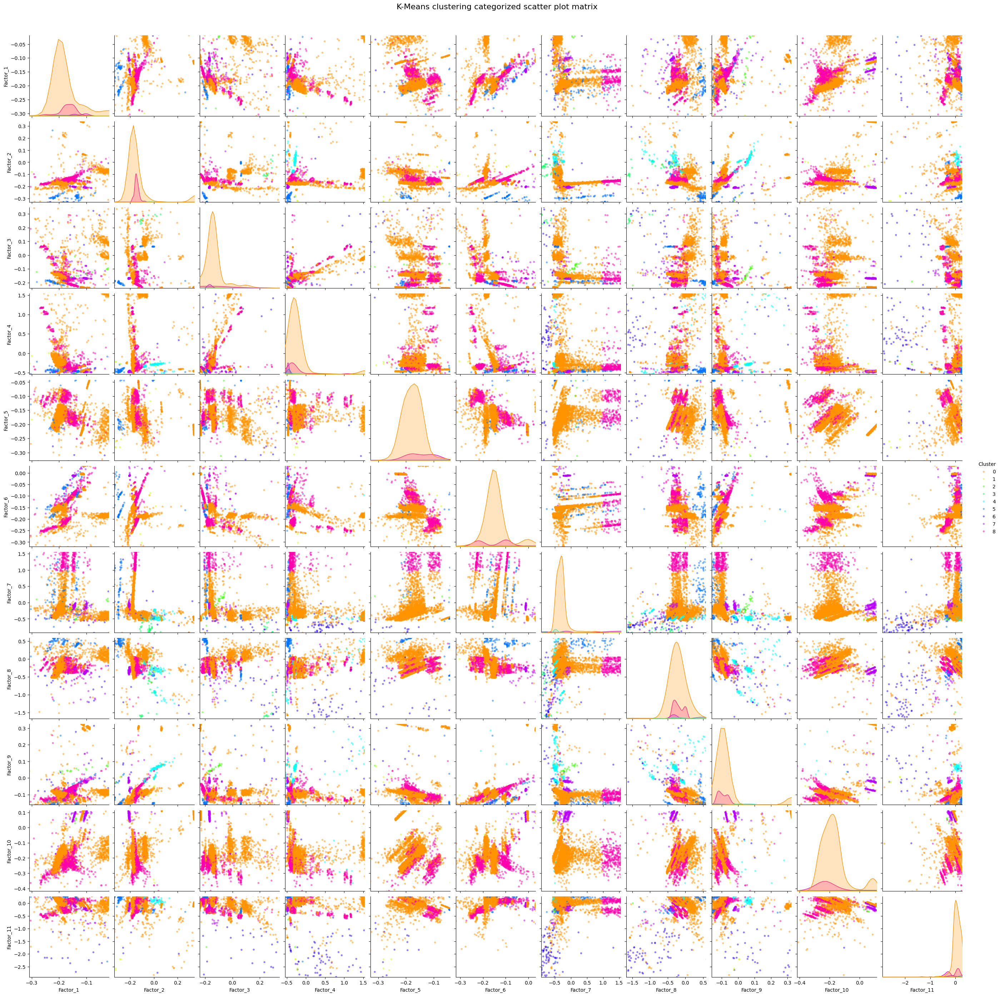

In [38]:
# Define a color map for the predicted clusters
kmeans_palette = sns.color_palette("hsv", optimal_k_kmeans)
kmeans_color_map = {i: kmeans_palette[i] for i in range(optimal_k_kmeans)}

# Generate the pairplot
plot_cluster_pairplot(
    df_factors=df_factors,
    labels=kmeans_labels,
    color_map=kmeans_color_map,
    n_samples=n_samples,
    lower_quantile=lower_quantile,
    upper_quantile=upper_quantile,
    title=f"K-Means clustering categorized scatter plot matrix"
)

### Finding optimal parameters

Chosen min_samples for DBSCAN: 128
Calculating nearest neighbor distances on a subsample of 63776 points...


C:\Users\kasht\AppData\Local\Temp\ipykernel_12192\2701034695.py:35: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


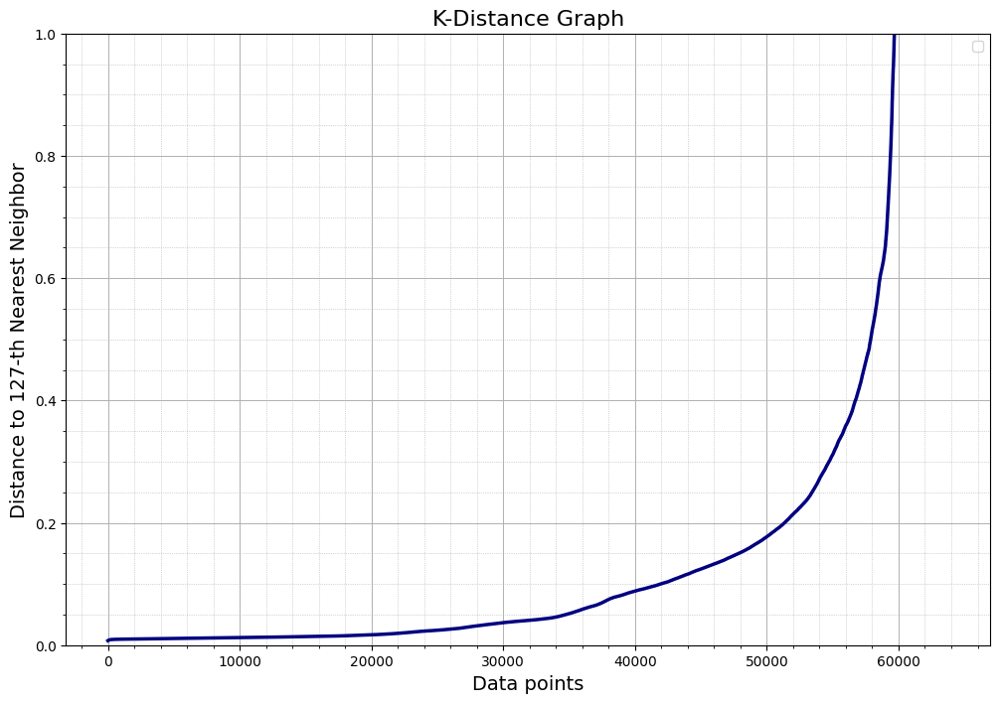

In [39]:
# Define min_samples
min_samples_for_dbscan = 128
print(f"Chosen min_samples for DBSCAN: {min_samples_for_dbscan}")

# Calculate k-distances
print(f"Calculating nearest neighbor distances on a subsample of {len(df_factors)} points...")

neighbors = NearestNeighbors(n_neighbors=min_samples_for_dbscan)
neighbors.fit(df_factors)

# Get the distances and indices of the neighbors for each point
distances, indices = neighbors.kneighbors(df_factors)

# The distance to the k-th neighbor is the last column of the distances matrix
kth_distances = distances[:, -1]

# Plot the k-distance graph
sorted_distances = np.sort(kth_distances)

# Create the plot
plt.figure(figsize=(12, 8))
plt.plot(sorted_distances, color='navy', linewidth=2.5)

# Customize the plot for detailed analysis
plt.title('K-Distance Graph', fontsize=16)
plt.xlabel('Data points', fontsize=14)
plt.ylabel(f'Distance to {min_samples_for_dbscan-1}-th Nearest Neighbor', fontsize=14)

plt.ylim(0, 1) 

plt.minorticks_on()
plt.grid(which='major', linestyle='-', linewidth='0.7')
plt.grid(which='minor', linestyle=':', linewidth='0.5')

plt.legend()
plt.show()

### DBSCAN method

In [40]:
# Define parameters
eps_dbscan = 0.15
min_samples_dbscan = 128
print(f"Initializing DBSCAN with eps={eps_dbscan} and min_samples={min_samples_dbscan}.")

# Instantiate and fit the model
dbscan = DBSCAN(eps=eps_dbscan, min_samples=min_samples_dbscan, n_jobs=-1)

# Fit the model to the factorized data
print("Fitting DBSCAN model...")
dbscan_labels = dbscan.fit_predict(df_factors)

# Display a summary of the results
unique_labels_dbscan = set(dbscan_labels)
n_clusters_dbscan = len(unique_labels_dbscan) - (1 if -1 in unique_labels_dbscan else 0)
n_noise_dbscan = list(dbscan_labels).count(-1)

print("\nDBSCAN clustering complete.")
print(f"Estimated number of clusters: {n_clusters_dbscan}")
print(f"Estimated number of noise points: {n_noise_dbscan} ({n_noise_dbscan / len(dbscan_labels) * 100:.2f}%)")
print(f"Unique cluster labels found: {np.unique(dbscan_labels)}")
print("\nFirst 20 cluster assignments:")
print(dbscan_labels[:20])

Initializing DBSCAN with eps=0.15 and min_samples=128.
Fitting DBSCAN model...

DBSCAN clustering complete.
Estimated number of clusters: 13
Estimated number of noise points: 12751 (19.99%)
Unique cluster labels found: [-1  0  1  2  3  4  5  6  7  8  9 10 11 12]

First 20 cluster assignments:
[ 0  0  0 -1 -1  1  0  0  0  0  0  0  0  0  1  2  0  0  0 -1]


In [41]:
# Calculate and print external/internal quality metrics
print("Calculating quality metrics for DBSCAN clustering...")
dbscan_metrics = calculate_and_print_metrics(
    data=df_factors,
    true_labels=ground_truth,
    predicted_labels=dbscan_labels
)

# Analyze and print cluster characteristics
print("Analyzing cluster characteristics for DBSCAN...")
analyze_clusters(
    data=df_factors, 
    labels=dbscan_labels
)

Calculating quality metrics for DBSCAN clustering...
External metrics:
- Rand Index (RI):           0.5294
- Adjusted Rand Index (ARI): 0.1676
- Jaccard Index:             0.4520

Internal metrics:
- Silhouette Score:        0.5161
- Compactness (WSS):       521563.5318
- Separation (BSS):        179971.5308
Analyzing cluster characteristics for DBSCAN...
Size of each cluster:
-1     12751
 0     38176
 1      3607
 2      2029
 3       405
 4      1345
 5       625
 6       165
 7       420
 8      1612
 9       393
 10      240
 11     1711
 12      297
Name: count, dtype: int64
Cluster centers:
    Factor_1  Factor_2  Factor_3  Factor_4  Factor_5  Factor_6  Factor_7  \
0  -0.197990 -0.175576 -0.146597 -0.288914 -0.175254 -0.150217 -0.285869   
1  -0.115225  0.348874 -0.233138 -0.462558 -0.219387 -0.005029 -0.489027   
2  -0.005901 -0.091101 -0.012754  1.559116 -0.179495 -0.184442 -0.419706   
3   5.769480  0.017624  1.445109 -0.281466  0.445918  0.554885 -0.488732   
4  -0.151378 -0

c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\numpy\_core\fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


{'sizes': -1     12751
  0     38176
  1      3607
  2      2029
  3       405
  4      1345
  5       625
  6       165
  7       420
  8      1612
  9       393
  10      240
  11     1711
  12      297
 Name: count, dtype: int64,
 'centers':     Factor_1  Factor_2  Factor_3  Factor_4  Factor_5  Factor_6  Factor_7  \
 0  -0.197990 -0.175576 -0.146597 -0.288914 -0.175254 -0.150217 -0.285869   
 1  -0.115225  0.348874 -0.233138 -0.462558 -0.219387 -0.005029 -0.489027   
 2  -0.005901 -0.091101 -0.012754  1.559116 -0.179495 -0.184442 -0.419706   
 3   5.769480  0.017624  1.445109 -0.281466  0.445918  0.554885 -0.488732   
 4  -0.151378 -0.132612 -0.214197 -0.405364 -0.180736 -0.099935  2.764944   
 5  -0.145602 -0.153536  0.633240 -0.408007 -0.178106 -0.093098  1.374868   
 6  -0.108595  0.063988 -0.236482 -0.437490 -0.139657  0.033466 -0.487616   
 7  -0.103457 -0.210496 -0.164116 -0.477418  6.332657  0.044560 -0.153314   
 8  -0.179384 -0.148834 -0.158262 -0.345067 -0.098675 -0.217190

Generating silhouette plot for 'DBSCAN' (found 13 clusters)...
The average silhouette score for all clustered points is: 0.7968


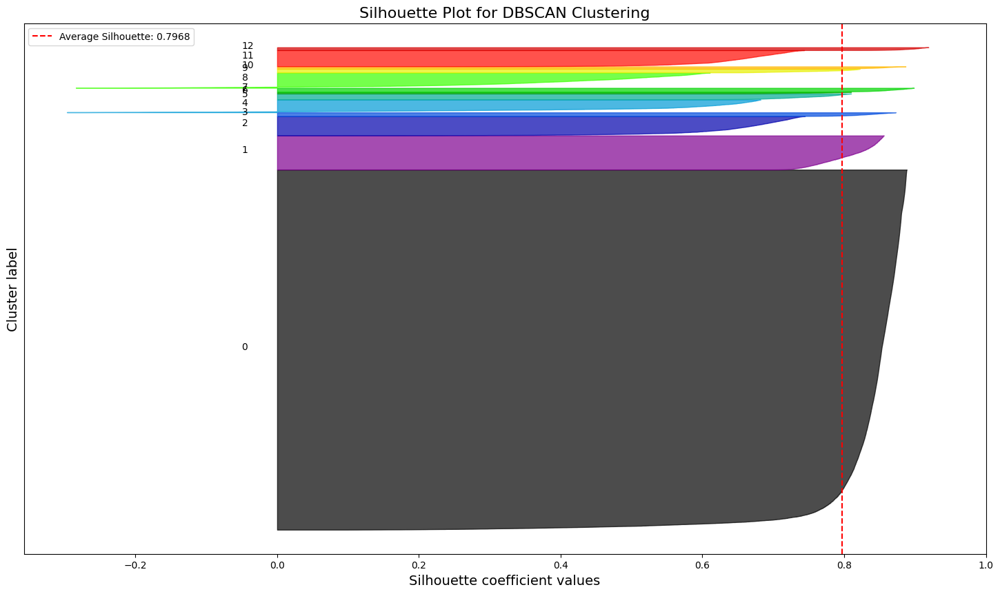

In [42]:
# Plot the silhouette diagram
plot_silhouette_diagram(
    data=df_factors,
    labels=dbscan_labels,
    model_name="DBSCAN"
)

Calculating feature importance for 'DBSCAN'...


<Figure size 1600x1200 with 0 Axes>

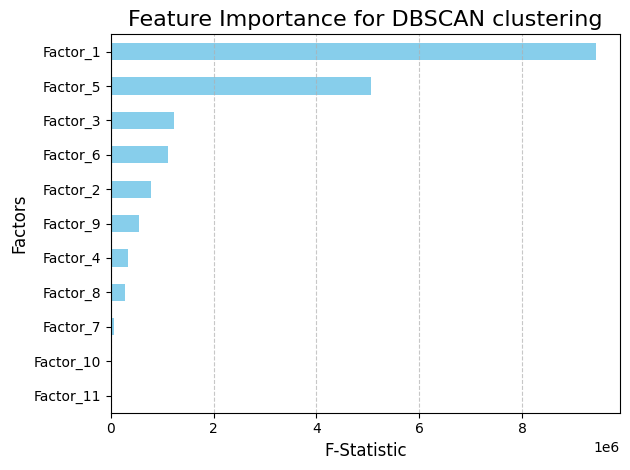

Feature importance ranking:
            F-Statistic
Factor_1   9.430352e+06
Factor_5   5.056778e+06
Factor_3   1.228094e+06
Factor_6   1.116978e+06
Factor_2   7.842417e+05
Factor_9   5.506691e+05
Factor_4   3.400224e+05
Factor_8   2.837989e+05
Factor_7   5.900573e+04
Factor_10  3.091659e+04
Factor_11  3.253721e+03


In [43]:
# Calculate and plot feature importance
dbscan_importance = plot_feature_importance(
    data=df_factors,
    labels=dbscan_labels,
    model_name="DBSCAN"
)
if dbscan_importance is not None:
    print("Feature importance ranking:")
    print(dbscan_importance)

Generating pairplot for 'DBSCAN clustering categorized scatter plot matrix' using 8192 sample points...


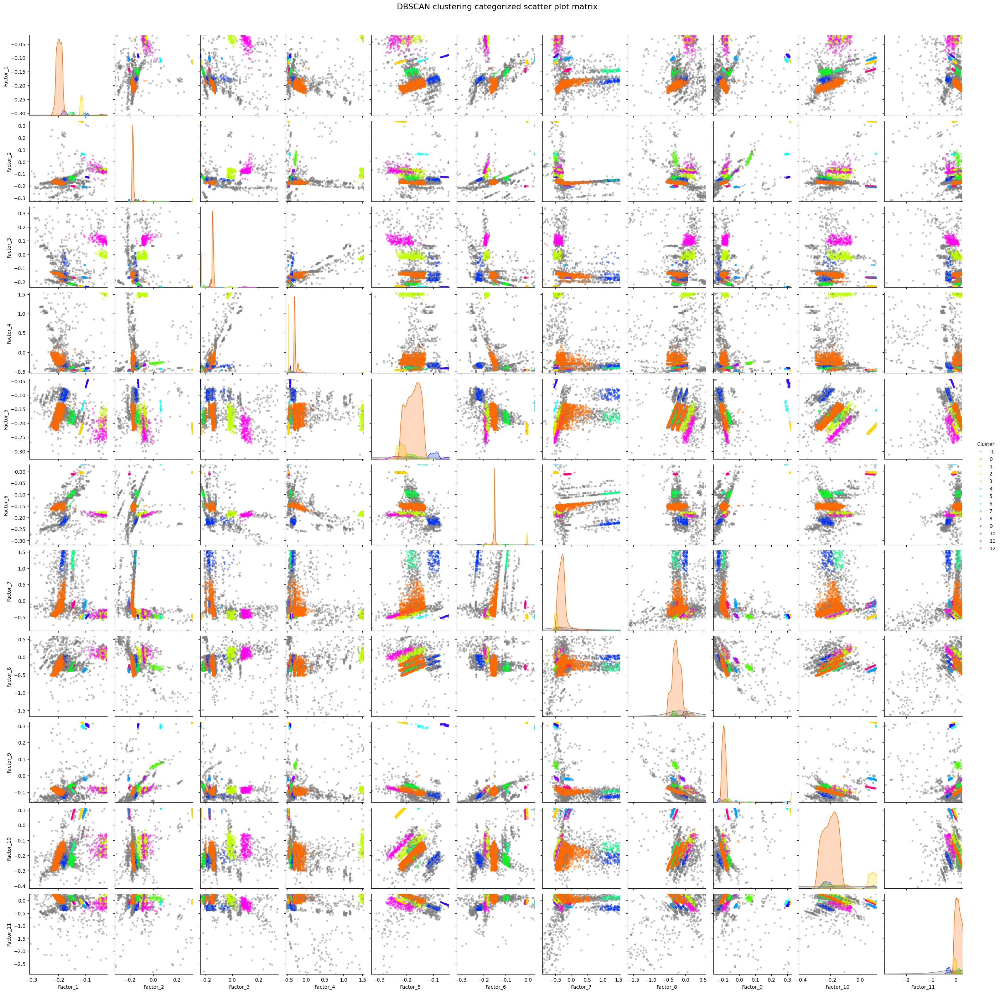

In [44]:
# Create a custom color map that includes noise 
unique_labels = sorted(list(set(dbscan_labels)))
n_colors = len(unique_labels)

# Generate a palette for the actual clusters
cluster_palette = sns.color_palette("hsv", n_clusters_dbscan)

# Create the final color map
dbscan_color_map = {}
cluster_idx = 0
for label in unique_labels:
    if label == -1:
        dbscan_color_map[label] = (0.5, 0.5, 0.5, 1)
    else:
        dbscan_color_map[label] = cluster_palette[cluster_idx]
        cluster_idx += 1

# Generate the pairplot
plot_cluster_pairplot(
    df_factors=df_factors,
    labels=dbscan_labels,
    color_map=dbscan_color_map,
    n_samples=n_samples,
    lower_quantile=lower_quantile,
    upper_quantile=upper_quantile,
    title=f"DBSCAN clustering categorized scatter plot matrix"
)

### HDBSCAN method

In [45]:
# Define parameters
hdbscan_params = {
    'min_cluster_size': 128,
    'min_samples': 128,
    'cluster_selection_epsilon': 0.15,
}
print(f"Initializing HDBSCAN with parameters: {hdbscan_params}")

# Instantiate and fit the HDBSCAN model
hdbscan_clusterer = hdbscan.HDBSCAN(**hdbscan_params)

print("Fitting HDBSCAN model...")
hdbscan_labels = hdbscan_clusterer.fit_predict(df_factors)

# Display a summary of the results
unique_labels_hdbscan = set(hdbscan_labels)
n_clusters_hdbscan = len(unique_labels_hdbscan) - (1 if -1 in unique_labels_hdbscan else 0)
n_noise_hdbscan = list(hdbscan_labels).count(-1)

print("\nHDBSCAN clustering complete.")
print(f"Estimated number of clusters: {n_clusters_hdbscan}")
print(f"Estimated number of noise points: {n_noise_hdbscan} ({n_noise_hdbscan / len(hdbscan_labels) * 100:.2f}%)")
print(f"Unique cluster labels found: {np.unique(hdbscan_labels)}")
print("\nFirst 20 cluster assignments:")
print(hdbscan_labels[:20])

Initializing HDBSCAN with parameters: {'min_cluster_size': 128, 'min_samples': 128, 'cluster_selection_epsilon': 0.15}
Fitting HDBSCAN model...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(



HDBSCAN clustering complete.
Estimated number of clusters: 20
Estimated number of noise points: 8067 (12.65%)
Unique cluster labels found: [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]

First 20 cluster assignments:
[17 17 17  3 -1  9 17 17 17 17 17 17 17 17  9 16 17 17 17 -1]


In [46]:
# Calculate and print external/internal quality metrics
print("Calculating quality metrics for HDBSCAN clustering...")
hdbscan_metrics = calculate_and_print_metrics(
    data=df_factors,
    true_labels=ground_truth,
    predicted_labels=hdbscan_labels
)

# Analyze and print cluster characteristics
print("Analyzing cluster characteristics for HDBSCAN...")
analyze_clusters(
    data=df_factors, 
    labels=hdbscan_labels
)

Calculating quality metrics for HDBSCAN clustering...
External metrics:
- Rand Index (RI):           0.5472
- Adjusted Rand Index (ARI): 0.1971
- Jaccard Index:             0.4678

Internal metrics:
- Silhouette Score:        0.4704
- Compactness (WSS):       423065.2741
- Separation (BSS):        278469.7886
Analyzing cluster characteristics for HDBSCAN...
Size of each cluster:
-1      8067
 0       985
 1       193
 2       183
 3       145
 4       272
 5       434
 6       487
 7       322
 8       245
 9      3607
 10      393
 11      165
 12      715
 13      132
 14      816
 15     1776
 16     2051
 17    39489
 18     1435
 19     1864
Name: count, dtype: int64
Cluster centers:
    Factor_1  Factor_2  Factor_3  Factor_4  Factor_5  Factor_6  Factor_7  \
0  -0.178412 -0.279812  0.191930 -0.427333 -0.035022 -0.106524  0.793057   
1  -0.359350  0.179370  0.042011 -0.606918 -0.017771 -0.450805 -0.324651   
2   6.746124 -0.740834  2.272614  1.508544  0.783593  0.267251 -0.470860  

c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\numpy\_core\fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


{'sizes': -1      8067
  0       985
  1       193
  2       183
  3       145
  4       272
  5       434
  6       487
  7       322
  8       245
  9      3607
  10      393
  11      165
  12      715
  13      132
  14      816
  15     1776
  16     2051
  17    39489
  18     1435
  19     1864
 Name: count, dtype: int64,
 'centers':     Factor_1  Factor_2  Factor_3  Factor_4  Factor_5  Factor_6  Factor_7  \
 0  -0.178412 -0.279812  0.191930 -0.427333 -0.035022 -0.106524  0.793057   
 1  -0.359350  0.179370  0.042011 -0.606918 -0.017771 -0.450805 -0.324651   
 2   6.746124 -0.740834  2.272614  1.508544  0.783593  0.267251 -0.470860   
 3   7.097091  0.010199  1.386856 -0.541612  0.040904  0.369600 -0.260680   
 4   6.791680 -0.074684  1.375425 -0.337946  0.398531  0.322725 -0.458585   
 5   5.763477  0.019579  1.444216 -0.282202  0.443520  0.556615 -0.487914   
 6  -0.104446 -0.209498 -0.160320 -0.477075  6.360695  0.043078 -0.160450   
 7  -0.146754 -0.203782 -0.168567 -0.45431

Generating silhouette plot for 'HDBSCAN' (found 20 clusters)...
The average silhouette score for all clustered points is: 0.6350


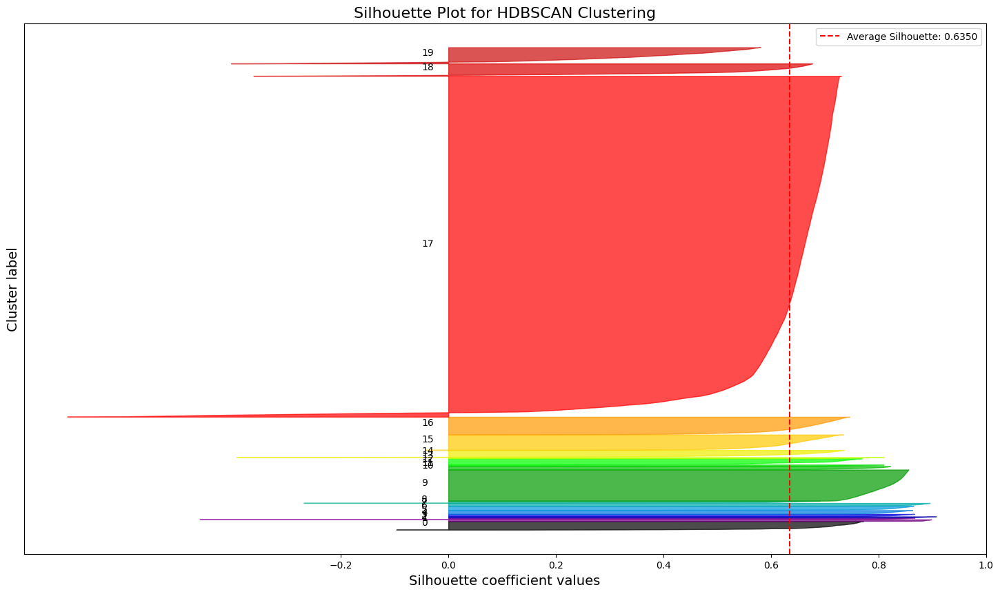

In [47]:
# Plot the silhouette diagram
plot_silhouette_diagram(
    data=df_factors,
    labels=hdbscan_labels,
    model_name="HDBSCAN"
)

Calculating feature importance for 'HDBSCAN'...


<Figure size 1600x1200 with 0 Axes>

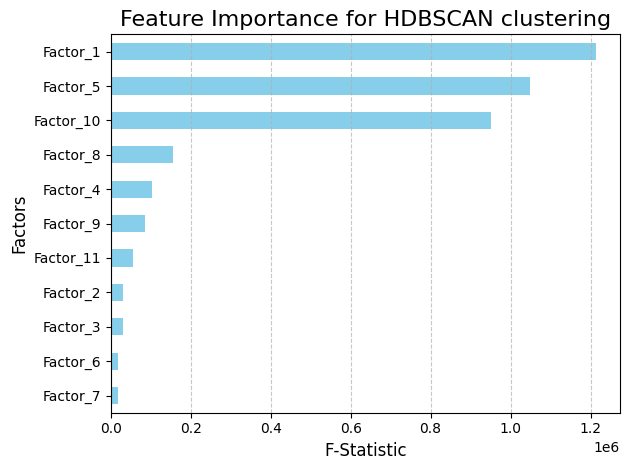

Feature Importance Ranking (HDBSCAN):
            F-Statistic
Factor_1   1.213108e+06
Factor_5   1.049459e+06
Factor_10  9.499281e+05
Factor_8   1.544652e+05
Factor_4   1.020848e+05
Factor_9   8.675560e+04
Factor_11  5.445544e+04
Factor_2   3.137278e+04
Factor_3   3.045303e+04
Factor_6   1.850620e+04
Factor_7   1.749150e+04


In [48]:
# Calculate and plot feature importance
hdbscan_importance = plot_feature_importance(
    data=df_factors,
    labels=hdbscan_labels,
    model_name="HDBSCAN"
)
if hdbscan_importance is not None:
    print("Feature Importance Ranking (HDBSCAN):")
    print(hdbscan_importance)

Generating pairplot for 'HDBSCAN clustering categorized scatter plot matrix' using 8192 sample points...


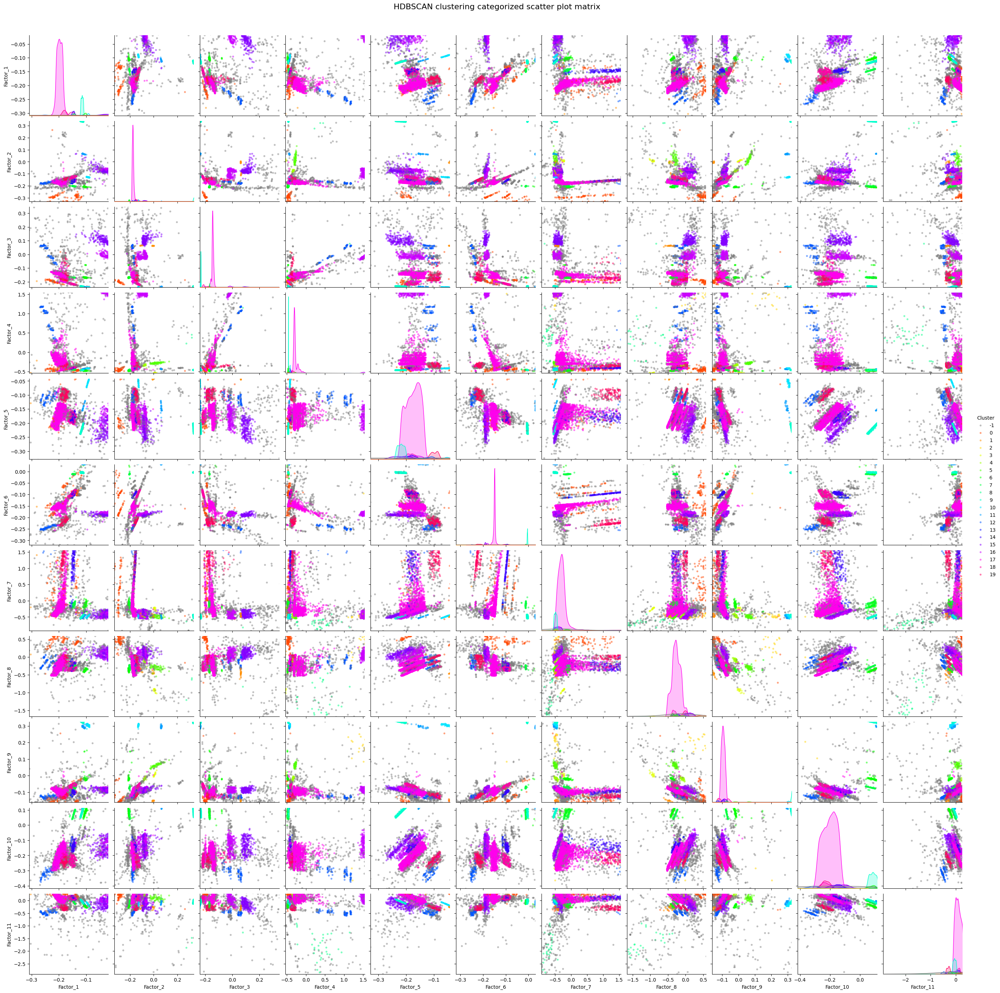

In [49]:
# Create a custom color map that includes noise
unique_labels = sorted(list(set(hdbscan_labels)))
n_colors = len(unique_labels)
cluster_palette = sns.color_palette("hsv", n_clusters_hdbscan)

hdbscan_color_map = {}
cluster_idx = 0
for label in unique_labels:
    if label == -1:
        hdbscan_color_map[label] = (0.5, 0.5, 0.5, 1)
    else:
        hdbscan_color_map[label] = cluster_palette[cluster_idx]
        cluster_idx += 1

# Generate the pairplot
plot_cluster_pairplot(
    df_factors=df_factors,
    labels=hdbscan_labels,
    color_map=hdbscan_color_map,
    n_samples=n_samples,
    lower_quantile=lower_quantile,
    upper_quantile=upper_quantile,
    title=f"HDBSCAN clustering categorized scatter plot matrix"
)

### Comparing results

In [50]:
# Create a dictionary to hold the metrics from all models
all_metrics = {
    'K-Means': kmeans_metrics,
    'DBSCAN': dbscan_metrics,
    'HDBSCAN': hdbscan_metrics
}

# Convert the dictionary of dictionaries into a pandas DataFrame
metrics_df = pd.DataFrame(all_metrics)

# Display the comparative table
print("Comparative metrics table:")
print(metrics_df)

Comparative metrics table:
                     K-Means         DBSCAN        HDBSCAN
Rand Index          0.762552       0.529424       0.547192
ARI                 0.396598       0.167591       0.197123
Jaccard Index       0.726319       0.451961       0.467753
Silhouette          0.559682       0.516129       0.470418
Compactness    284491.830850  521563.531809  423065.274074
Separation     417043.231794  179971.530835  278469.788570


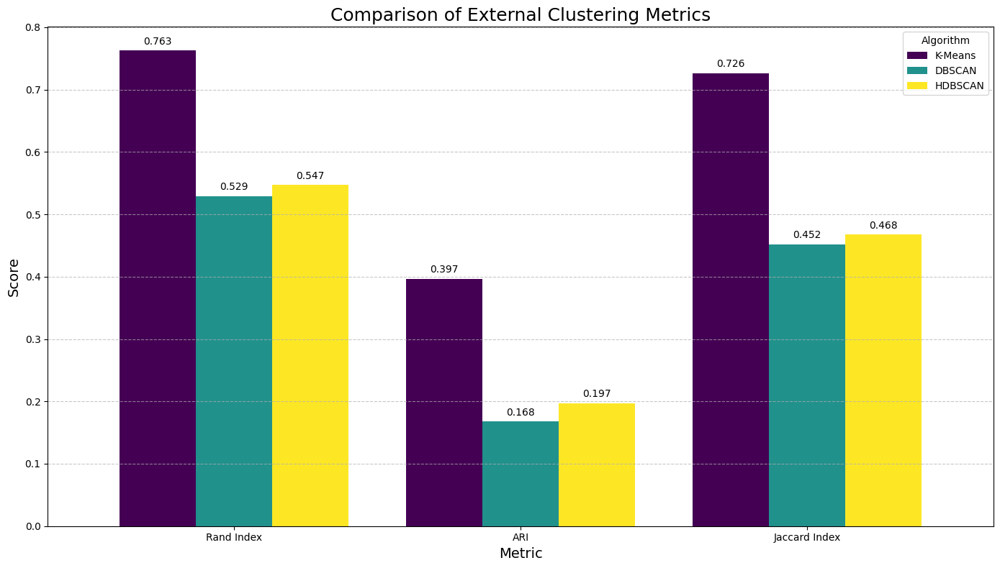

In [51]:
# Select only the external metrics
external_metrics_df = metrics_df.loc[['Rand Index', 'ARI', 'Jaccard Index']]

# Create the bar plot
ax = external_metrics_df.plot(
    kind='bar',
    figsize=(14, 8),
    width=0.8,
    cmap='viridis'
)

# Customize the plot for clarity
plt.title('Comparison of External Clustering Metrics', fontsize=18)
plt.ylabel('Score', fontsize=14)
plt.xlabel('Metric', fontsize=14)
plt.xticks(rotation=0, ha='center')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='Algorithm')

# Add value labels on top of each bar for precise comparison
for p in ax.patches:
    ax.annotate(
        f'{p.get_height():.3f}',
        (p.get_x() + p.get_width() / 2., p.get_height()),
        ha='center',
        va='center',
        xytext=(0, 9),
        textcoords='offset points'
    )

plt.tight_layout()
plt.show()

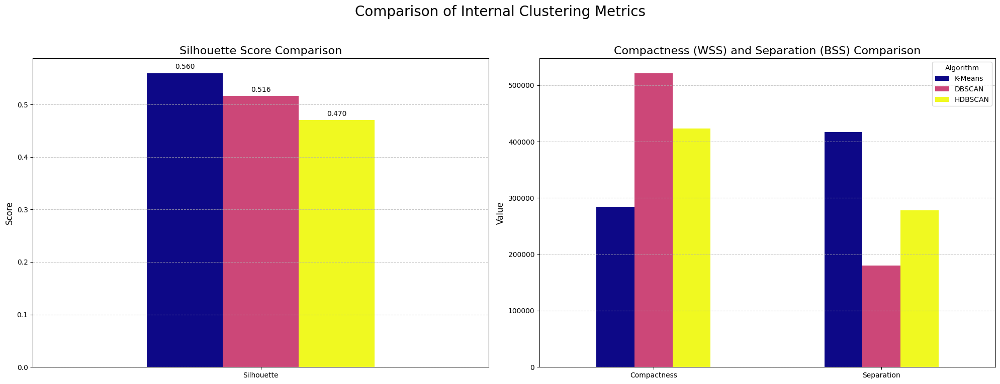

In [52]:
# Select internal metrics only
internal_metrics_df = metrics_df.loc[['Silhouette', 'Compactness', 'Separation']]

fig, axes = plt.subplots(1, 2, figsize=(20, 8))
fig.suptitle('Comparison of Internal Clustering Metrics', fontsize=20)

# Plot for Silhouette Score
silhouette_df = internal_metrics_df.loc[['Silhouette']]
silhouette_df.plot(kind='bar', ax=axes[0], cmap='plasma', legend=False)
axes[0].set_title('Silhouette Score Comparison', fontsize=16)
axes[0].set_ylabel('Score', fontsize=12)
axes[0].tick_params(axis='x', rotation=0)
axes[0].grid(axis='y', linestyle='--', alpha=0.7)
for p in axes[0].patches:
    axes[0].annotate(f'{p.get_height():.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 9), textcoords='offset points')

# Plot for Compactness (WSS) and Separation (BSS)
compactness_separation_df = internal_metrics_df.loc[['Compactness', 'Separation']]
compactness_separation_df.plot(kind='bar', ax=axes[1], cmap='plasma')
axes[1].set_title('Compactness (WSS) and Separation (BSS) Comparison', fontsize=16)
axes[1].set_ylabel('Value', fontsize=12)
axes[1].tick_params(axis='x', rotation=0)
axes[1].grid(axis='y', linestyle='--', alpha=0.7)
axes[1].legend(title='Algorithm')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

Cluster structure summary:
         Number of Clusters  Noise Points (%)
K-Means                 9.0          0.000000
DBSCAN                 13.0         19.993414
HDBSCAN                20.0         12.648959


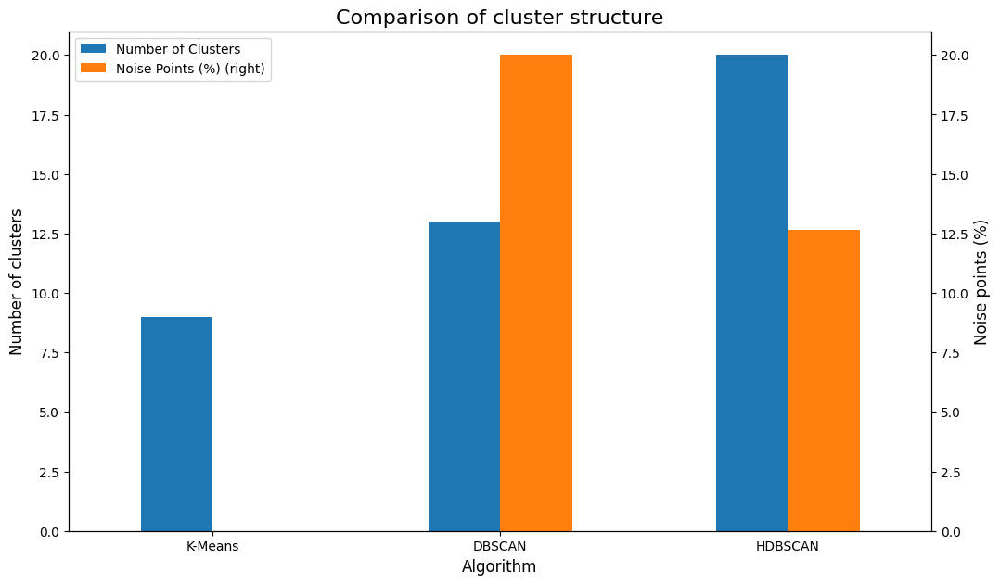

In [53]:
# Calculate cluster counts and noise percentages
summary_data = {
    'K-Means': {
        'Number of Clusters': len(np.unique(kmeans_labels)),
        'Noise Points (%)': 0
    },
    'DBSCAN': {
        'Number of Clusters': len(np.unique(dbscan_labels)) - (1 if -1 in dbscan_labels else 0),
        'Noise Points (%)': np.sum(dbscan_labels == -1) / len(dbscan_labels) * 100
    },
    'HDBSCAN': {
        'Number of Clusters': len(np.unique(hdbscan_labels)) - (1 if -1 in hdbscan_labels else 0),
        'Noise Points (%)': np.sum(hdbscan_labels == -1) / len(hdbscan_labels) * 100
    }
}

summary_df = pd.DataFrame(summary_data).T

# Display the summary table
print("Cluster structure summary:")
print(summary_df)

# Visualize the summary
ax = summary_df.plot(
    kind='bar',
    y=['Number of Clusters', 'Noise Points (%)'],
    secondary_y='Noise Points (%)',
    figsize=(12, 7),
    rot=0
)

# Customize the plot
ax.set_title('Comparison of cluster structure', fontsize=16)
ax.set_xlabel('Algorithm', fontsize=12)
ax.set_ylabel('Number of clusters', fontsize=12)
ax.right_ax.set_ylabel('Noise points (%)', fontsize=12)
plt.show()

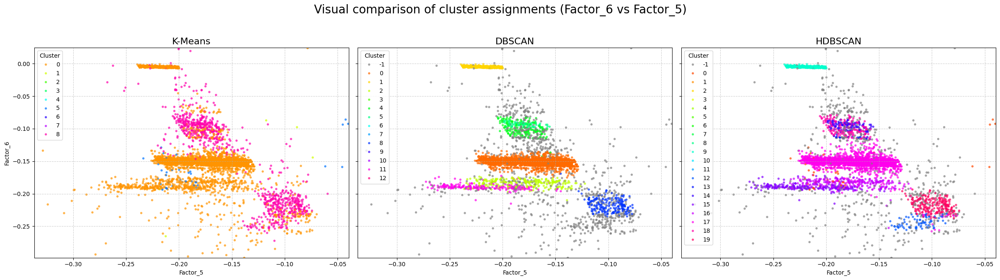

In [54]:
# Using the same factor pair for all plots for a direct comparison.
x_factor, y_factor = 'Factor_5', 'Factor_6'

# Prepare a sample of the data for plotting
df_plot_sample = df_factors.sample(n=n_samples, random_state=42)
df_plot_sample['KMeans_Label'] = kmeans_labels[df_plot_sample.index]
df_plot_sample['DBSCAN_Label'] = dbscan_labels[df_plot_sample.index]
df_plot_sample['HDBSCAN_Label'] = hdbscan_labels[df_plot_sample.index]

# Create a figure with three subplots
fig, axes = plt.subplots(1, 3, figsize=(24, 7), sharex=True, sharey=True)
fig.suptitle(f'Visual comparison of cluster assignments ({y_factor} vs {x_factor})', fontsize=20)

# Plot for K-Means
sns.scatterplot(
    data=df_plot_sample, x=x_factor, y=y_factor, hue='KMeans_Label',
    palette=kmeans_color_map,
    ax=axes[0], alpha=0.7, s=15, linewidth=0
)
axes[0].set_title(f'K-Means', fontsize=16)
axes[0].legend(title='Cluster')
axes[0].grid(True, linestyle='--', alpha=0.6)

# Plot for DBSCAN
sns.scatterplot(
    data=df_plot_sample, x=x_factor, y=y_factor, hue='DBSCAN_Label',
    palette=dbscan_color_map,
    ax=axes[1], alpha=0.7, s=15, linewidth=0
)
axes[1].set_title(f'DBSCAN', fontsize=16)
axes[1].legend(title='Cluster')
axes[1].grid(True, linestyle='--', alpha=0.6)

# Plot for HDBSCAN
sns.scatterplot(
    data=df_plot_sample, x=x_factor, y=y_factor, hue='HDBSCAN_Label',
    palette=hdbscan_color_map,
    ax=axes[2], alpha=0.7, s=15, linewidth=0
)
axes[2].set_title('HDBSCAN', fontsize=16)
axes[2].legend(title='Cluster')
axes[2].grid(True, linestyle='--', alpha=0.6)

# Set common limits based on quantiles
x_min, x_max = df_factors[x_factor].quantile([lower_quantile, upper_quantile])
y_min, y_max = df_factors[y_factor].quantile([lower_quantile, upper_quantile])
axes[0].set_xlim(x_min, x_max)
axes[0].set_ylim(y_min, y_max)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

### Comparing models with hyperparameters changes

In [ ]:
# Define the parameter grid to search
param_grid = {
    'min_samples': [32, 64, 128, 256, 512],
    'cluster_selection_epsilon': [0.10, 0.15, 0.20, 0.25, 0.30]
}

# Set up the experiment loop
results = []
total_runs = len(param_grid['min_samples']) * len(param_grid['cluster_selection_epsilon'])
current_run = 0

print(f"Starting grid search for HDBSCAN over {total_runs} parameter combinations...")

for ms in param_grid['min_samples']:
    for eps in param_grid['cluster_selection_epsilon']:
        current_run += 1
        print(f"  [{current_run}/{total_runs}] Running with min_samples={ms}, cluster_selection_epsilon={eps}...")
        
        # Instantiate and fit the HDBSCAN model
        clusterer = hdbscan.HDBSCAN(
            min_cluster_size=128,
            min_samples=ms,
            cluster_selection_epsilon=eps
        )
        labels = clusterer.fit_predict(df_factors)
        
        # Calculate metrics
        contingency = metrics.cluster.contingency_matrix(ground_truth, labels)
        tp = np.sum(contingency * (contingency - 1) / 2)
        fp = np.sum(np.sum(contingency, axis=0) * (np.sum(contingency, axis=0) - 1) / 2) - tp
        fn = np.sum(np.sum(contingency, axis=1) * (np.sum(contingency, axis=1) - 1) / 2) - tp
        jaccard = tp / (tp + fp + fn) if (tp + fp + fn) > 0 else 0
        
        clustered_mask = labels != -1
        num_clusters = len(np.unique(labels[clustered_mask]))
        
        if num_clusters >= 2 and np.sum(clustered_mask) > num_clusters:
            silhouette = silhouette_score(df_factors[clustered_mask], labels[clustered_mask])
        else:
            silhouette = -1.0 

        # Store the results
        results.append({
            'min_samples': ms,
            'cluster_selection_epsilon': eps,
            'jaccard_index': jaccard,
            'silhouette_score': silhouette,
            'num_clusters': num_clusters,
            'noise_percentage': (1 - np.mean(clustered_mask)) * 100
        })
        
print("\nGrid search complete.")

Starting grid search for HDBSCAN over 25 parameter combinations...
  [1/25] Running with min_samples=32, cluster_selection_epsilon=0.1...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [2/25] Running with min_samples=32, cluster_selection_epsilon=0.15...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [3/25] Running with min_samples=32, cluster_selection_epsilon=0.2...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [4/25] Running with min_samples=32, cluster_selection_epsilon=0.25...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [5/25] Running with min_samples=32, cluster_selection_epsilon=0.3...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [6/25] Running with min_samples=64, cluster_selection_epsilon=0.1...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [7/25] Running with min_samples=64, cluster_selection_epsilon=0.15...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [8/25] Running with min_samples=64, cluster_selection_epsilon=0.2...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [9/25] Running with min_samples=64, cluster_selection_epsilon=0.25...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [10/25] Running with min_samples=64, cluster_selection_epsilon=0.3...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [11/25] Running with min_samples=128, cluster_selection_epsilon=0.1...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [12/25] Running with min_samples=128, cluster_selection_epsilon=0.15...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [13/25] Running with min_samples=128, cluster_selection_epsilon=0.2...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [14/25] Running with min_samples=128, cluster_selection_epsilon=0.25...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [15/25] Running with min_samples=128, cluster_selection_epsilon=0.3...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [16/25] Running with min_samples=256, cluster_selection_epsilon=0.1...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [17/25] Running with min_samples=256, cluster_selection_epsilon=0.15...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [18/25] Running with min_samples=256, cluster_selection_epsilon=0.2...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [19/25] Running with min_samples=256, cluster_selection_epsilon=0.25...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [20/25] Running with min_samples=256, cluster_selection_epsilon=0.3...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [21/25] Running with min_samples=512, cluster_selection_epsilon=0.1...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [22/25] Running with min_samples=512, cluster_selection_epsilon=0.15...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [23/25] Running with min_samples=512, cluster_selection_epsilon=0.2...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [24/25] Running with min_samples=512, cluster_selection_epsilon=0.25...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


  [25/25] Running with min_samples=512, cluster_selection_epsilon=0.3...


c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\kasht\Downloads\ML\.venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(



Grid search complete.


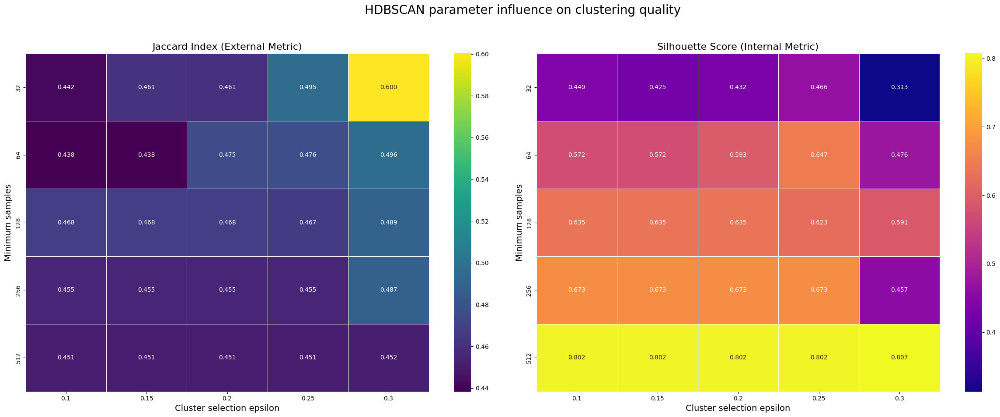


Detailed results from the grid search:
    min_samples  cluster_selection_epsilon  jaccard_index  silhouette_score  \
0            32                       0.10          0.442             0.440   
1            32                       0.15          0.461             0.425   
2            32                       0.20          0.461             0.432   
3            32                       0.25          0.495             0.466   
4            32                       0.30          0.600             0.313   
5            64                       0.10          0.438             0.572   
6            64                       0.15          0.438             0.572   
7            64                       0.20          0.475             0.593   
8            64                       0.25          0.476             0.647   
9            64                       0.30          0.496             0.476   
10          128                       0.10          0.468             0.635   
11          

In [78]:
# Process and pivot the results for visualization
results_df = pd.DataFrame(results)
jaccard_pivot = results_df.pivot(index='min_samples', columns='cluster_selection_epsilon', values='jaccard_index')
silhouette_pivot = results_df.pivot(index='min_samples', columns='cluster_selection_epsilon', values='silhouette_score')

# Visualize the results using heatmaps
fig, axes = plt.subplots(1, 2, figsize=(24, 10))
fig.suptitle('HDBSCAN parameter influence on clustering quality', fontsize=20)

# Heatmap for Jaccard Index
sns.heatmap(
    jaccard_pivot,
    annot=True,
    fmt=".3f",
    cmap="viridis",
    linewidths=.5,
    ax=axes[0]
)
axes[0].set_title('Jaccard Index (External Metric)', fontsize=16)
axes[0].set_xlabel('Cluster selection epsilon', fontsize=14)
axes[0].set_ylabel('Minimum samples', fontsize=14)

# Heatmap for Silhouette Score
sns.heatmap(
    silhouette_pivot,
    annot=True,
    fmt=".3f",
    cmap="plasma",
    linewidths=.5,
    ax=axes[1]
)
axes[1].set_title('Silhouette Score (Internal Metric)', fontsize=16)
axes[1].set_xlabel('Cluster selection epsilon', fontsize=14)
axes[1].set_ylabel('Minimum samples', fontsize=14)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

# Display the raw results table for detailed review
print("\nDetailed results from the grid search:")
print(results_df.round(3))